In [1]:
import os
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
src_path = os.path.abspath("../../src")
print(src_path)
if src_path not in sys.path:
    sys.path.append(src_path)

import data
import utils
from utils import *
from data import *

/sc/home/masoumeh.javanbakhat/netstore-old/Baysian/3D/Explainability/AdniGithub/src


In [3]:
# I saved the numpy arrays before normalaising and changing to tensor in the following path as numpy arrays:
# From here we can load images in order to use them for overlaying and checking heatmaps 
img_path = "../../adni_results/images"
gr1_np = np.load(os.path.join(img_path, "gr0_4591.npy"))
gr2_np = np.load(os.path.join(img_path, "gr1_4592.npy"))

print(gr1_np.shape)
print(gr2_np.shape)

(4591, 256, 256)
(4592, 256, 256)


In [29]:
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize

def show_overlay(imgs, heatmaps, idx, gr=1):
    img = imgs[idx]
    heatmap = heatmaps[idx]

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

    # Left: original image
    ax1.imshow(img, cmap="gray" if img.ndim == 2 else None)
    ax1.set_title(f"Group {gr} Image {idx}")
    ax1.axis("off")

    # Right: overlay built in the axes
    ax2.imshow(img, cmap="gray" if img.ndim == 2 else None)
    hm = ax2.imshow(heatmap, cmap="jet", alpha=0.5)  # <- this handle drives the colorbar
    ax2.set_title(f"Group {gr} Image {idx} with Heatmap Overlay")
    ax2.axis("off")

    cbar = fig.colorbar(hm, ax=ax2, fraction=0.046, pad=0.04)
    plt.show()


### Comparing Different Explainaibility Methods

##### GradCAM and GradCAM++ 

- Note that the reason that I used statistic from Image Net for normalisation is that I used these statistics for pretraining simCLR for feature extraction

- I tried different layesrs on Conv net but the last layer seems to work better.
- Conv3 is better than Conv2 for visualaising heatmaps 

- I saw hetmaps from both GradCAM and GradCAM++ the same 


- I also looked at the implimentation of my code and the one that chatGPT gave me, both implimentations were the same

In [40]:
# Exp1: gr1_100_96_cam_cam_batch8
# It means I used implimentation of gradcam from chatGPT that is the code from gradcam2.py
# "target_layer": "0.7.2.conv3"
# bs =8 and in each group we have 100 samples with last batch dropped (96 samples used)


base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 100
m1 = 96

expl = 'cam'
exp = 'cam_batch8'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{n_sample}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{n_sample}_{m1}_{expl}_{exp}.npy')
heat_gr1 = np.load(path_heatmaps1)
heat_gr2 = np.load(path_heatmaps2)
print(heat_gr1.shape)
print(heat_gr2.shape)

(96, 256, 256)
(96, 256, 256)


In [41]:
print(np.max(heat_gr1), np.min(heat_gr1))

print(np.max(heat_gr2), np.min(heat_gr2))

0.0019141232 3.6549325e-05
0.001584481 3.9836155e-05


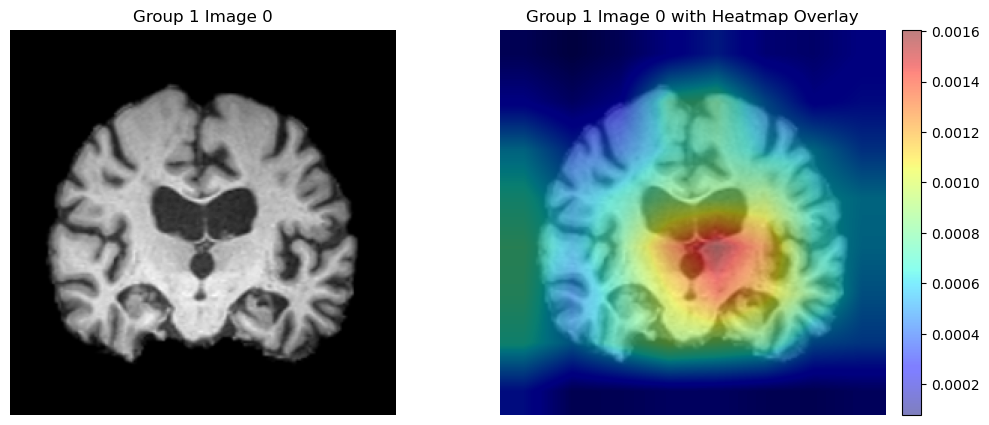

In [34]:
show_overlay(imgs=gr1_np, heatmaps=heat_gr1, idx=0, gr=1)

In [42]:

# Exp1: gr1_100_96_cam_cam_first_grad_batch8
# It means I used implimentation of gradcam from code that I had that is the code from gradcam.py
# "target_layer": "0.7.2.conv3"
# bs =8 and in each group we have 100 samples with last batch dropped (96 samples used)

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 100
m1 = 96

expl = 'cam'
exp = 'cam_first_grad'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{n_sample}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{n_sample}_{m1}_{expl}_{exp}.npy')
heat_gr1_first = np.load(path_heatmaps1)
heat_gr2_first = np.load(path_heatmaps2)
print(heat_gr1_first.shape)
print(heat_gr2_first.shape)

(96, 256, 256)
(96, 256, 256)


In [43]:
print(np.max(heat_gr1_first), np.min(heat_gr1_first))

print(np.max(heat_gr2_first), np.min(heat_gr2_first))

161.59132 3.085514
133.76276 3.3629916


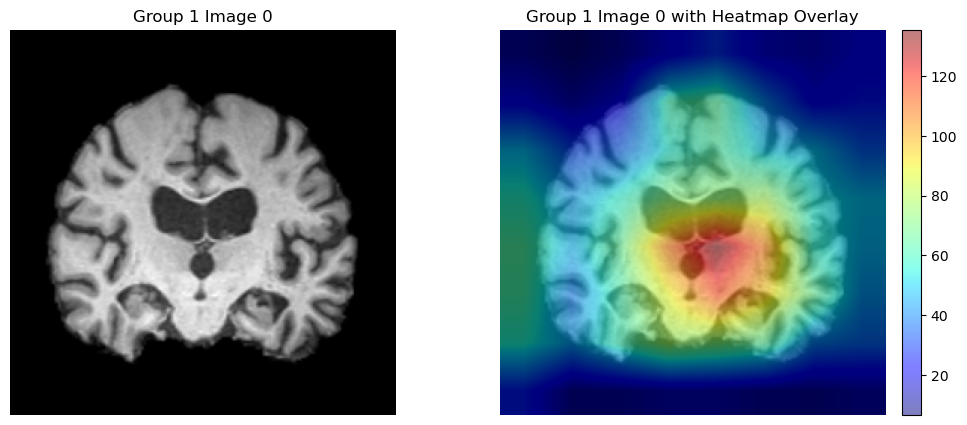

In [44]:
show_overlay(imgs=gr1_np, heatmaps=heat_gr1_first, idx=0, gr=1)

- In the above two experiments I wanted to see what is the difference between GradCAM in my implimentation and the other one that I found from chatGPT. It shows both impliemtations are the same. As they show the same regions.
- But the magnitude of feature importnaces in second implimentation is much bigger than first one  

## GradCAM++
- In below experiment I wanted to see the heatmpas from GradCAM++ to see if it shows the same regions as GradCAM

In [38]:
# Exp1: gr1_100_96_cam++_cam++_first_grad_batch8
# It means I used implimentation of gradcam++ from chatGPT implimentation of chatGPT
# "target_layer": "0.7.2.conv3"
# bs =8 and in each group we have 100 samples with last batch dropped (96 samples used)

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 100
m1 = 96

expl = 'cam++'
exp = 'cam++_batch8'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{n_sample}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{n_sample}_{m1}_{expl}_{exp}.npy')
heat_gr1_campp = np.load(path_heatmaps1)
heat_gr2_campp = np.load(path_heatmaps2)
print(heat_gr1_campp.shape)
print(heat_gr2_campp.shape)

(96, 256, 256)
(96, 256, 256)


In [46]:
print(np.max(heat_gr1_campp), np.min(heat_gr1_campp))
print(np.max(heat_gr2_campp), np.min(heat_gr2_campp))

0.0016904263 8.243437e-05
0.0016275212 2.6819998e-05


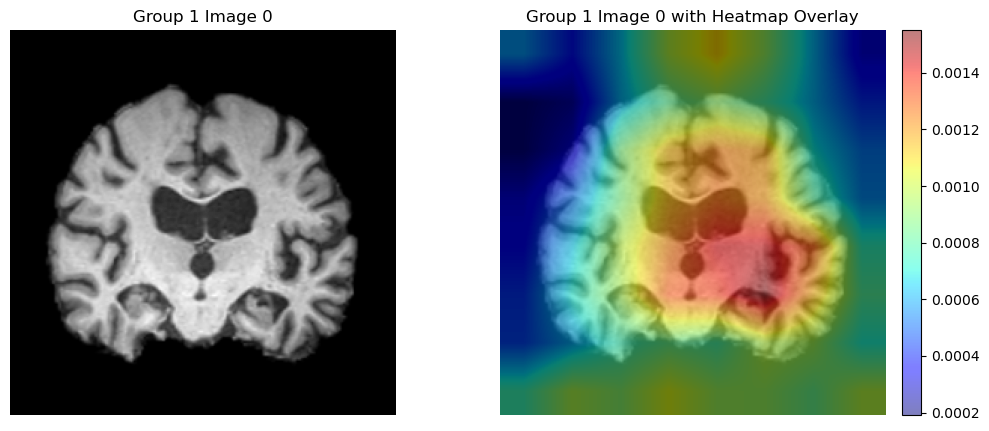

In [39]:
show_overlay(imgs=gr1_np, heatmaps=heat_gr1_campp, idx=0, gr=1)

## Random initialisation

- I used image net weight initialisation:
- test_statistic: 1.2760

- group 1, group2. 

- number of smaple: 64

- I did this experiment to see if simCLR representation learning is importnat or not

In [26]:
# Exp: Ranodm_init: 
# Expl: I used grad_cam++ from second implimentation (gradcam2.py)
# bs = 64
# n,m = 64 number of samples in each group
# in the second group I used corrupted images with 4% of most importnat features removed

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 64
m1 = 64

expl = 'cam++'
exp = 'cam++_rnd'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{64}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{64}_{m1}_{expl}_{exp}.npy')
heat_gr1_rnd = np.load(path_heatmaps1)
heat_gr2_rnd = np.load(path_heatmaps2)
print(heat_gr1_rnd.shape)
print(heat_gr2_rnd.shape)

(64, 256, 256)
(64, 256, 256)


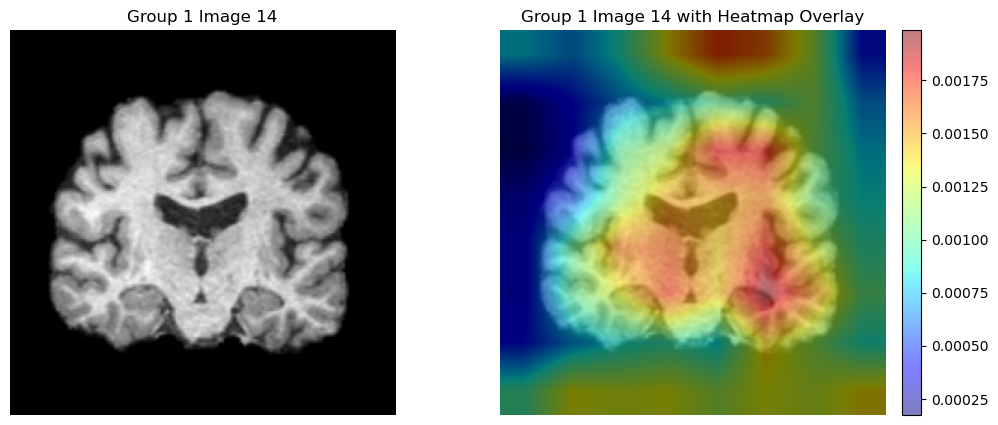

In [8]:
show_overlay(imgs=gr1_np, heatmaps=heat_gr1_rnd, idx=14, gr=1)

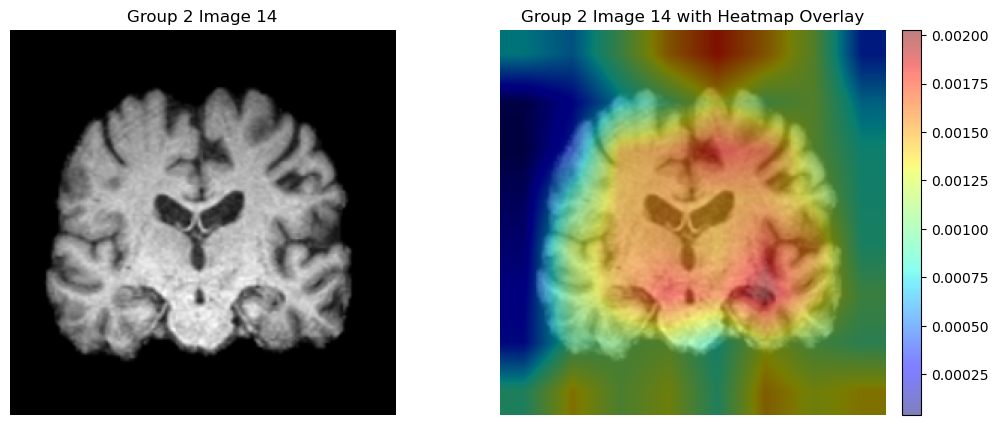

In [9]:
show_overlay(imgs=gr2_np, heatmaps=heat_gr2_rnd, idx=14, gr=2)

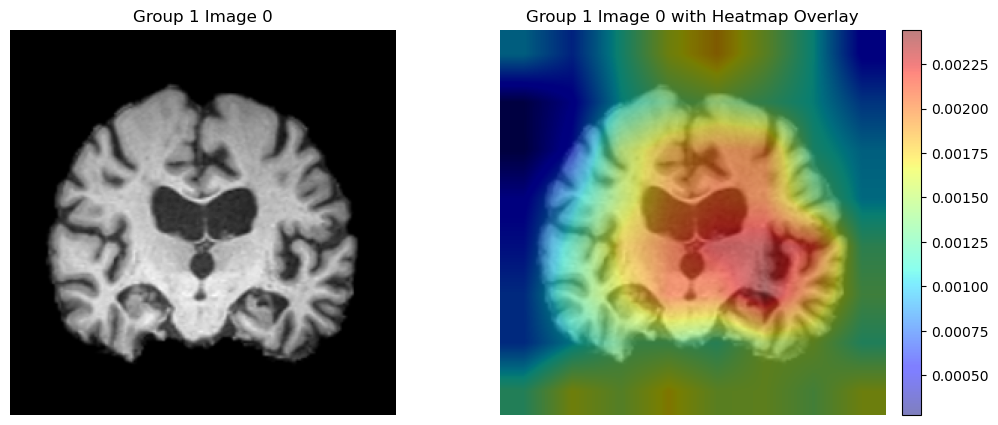

In [32]:
show_overlay(imgs=gr1_np, heatmaps=heat_gr1_rnd, idx=0, gr=1)

|  Exp     | Expl     | test_stat|two_groups|n-sam |
|----------|----------|----------|----------|------|
|cam-fnt   | cam      |  0.6386  | gr1, gr2 | 100  |
|----------|----------|----------|----------|------|
|cam-suppr | cam      | 0.1134   | gr1, gr2 | 100  | 
|          |          |          |          |      |
|          |          |          |gr1,gr1bl6|0.8766|
|cam-bl-test| cam     | 1.2267   |gr1,gr1bl | 100  |

In [3]:
# Exp: cam-fine-tuned : 
# Expl: I used grad_cam from second implimentation (gradcam2.py)
# bs = 100
# n,m = 100 number of samples in each group
# I am using the fine-tuned model on ADNI dataset and first and second group

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 100
m1 = 100

expl = 'cam'
exp = 'cam-fnt'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{100}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{100}_{m1}_{expl}_{exp}.npy')
heat_gr1_rnd = np.load(path_heatmaps1)
heat_gr2_rnd = np.load(path_heatmaps2)
print(heat_gr1_rnd.shape)
print(heat_gr2_rnd.shape)

(100, 256, 256)
(100, 256, 256)


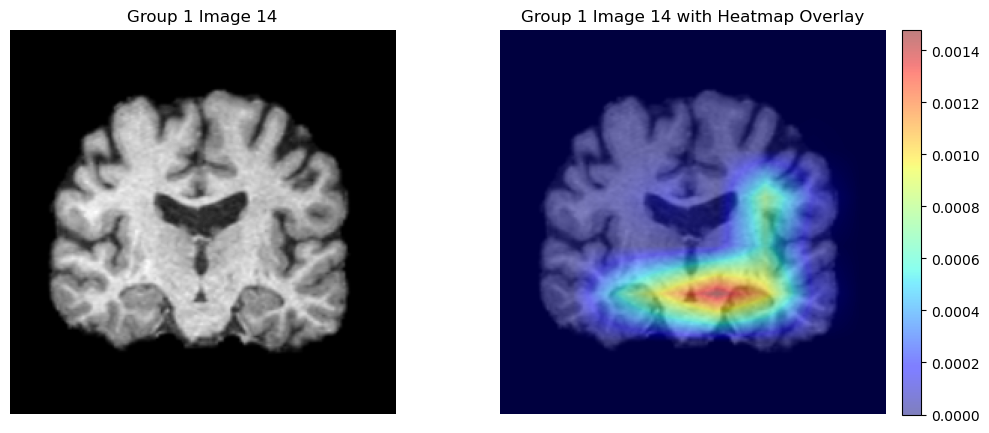

In [8]:
show_overlay(imgs=gr1_np, heatmaps=heat_gr1_rnd, idx=14, gr=1)

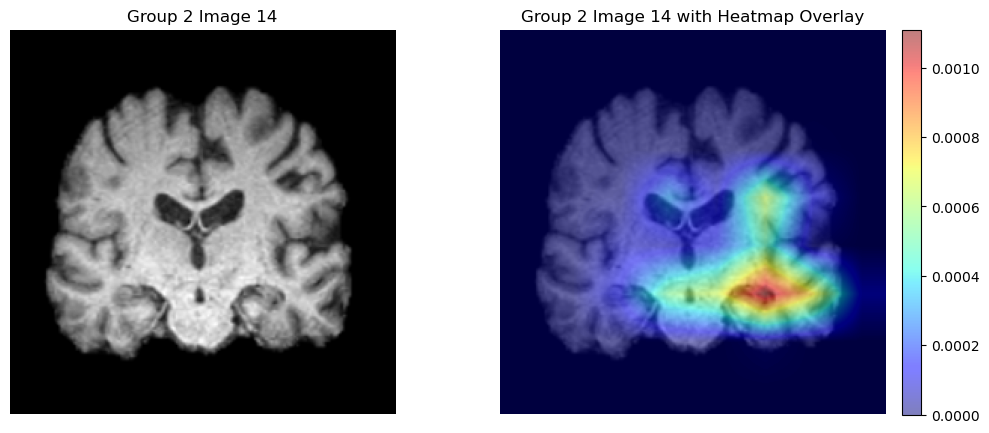

In [10]:
show_overlay(imgs=gr2_np, heatmaps=heat_gr2_rnd, idx=14, gr=2)

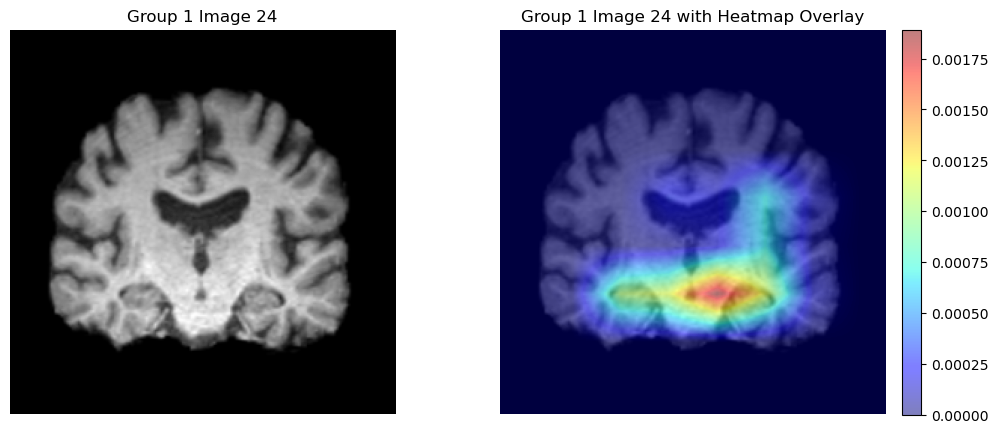

In [14]:
show_overlay(imgs=gr1_np, heatmaps=heat_gr1_rnd, idx=24, gr=1)

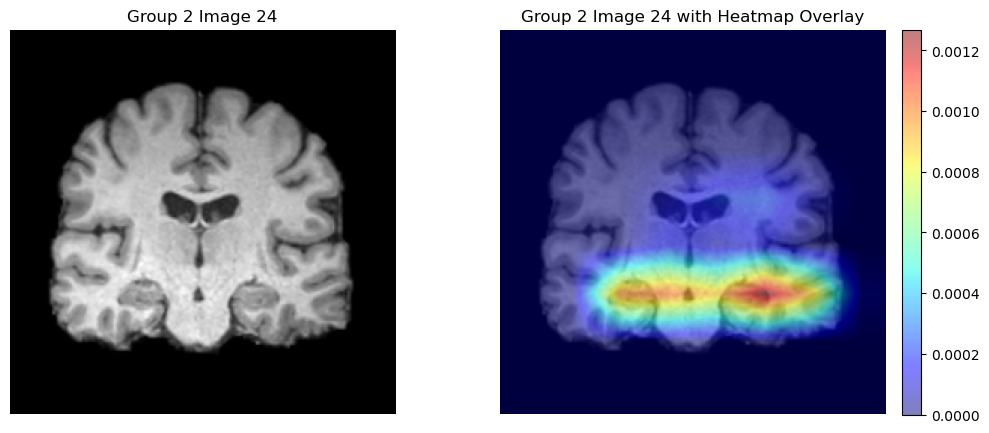

In [15]:
show_overlay(imgs=gr2_np, heatmaps=heat_gr2_rnd, idx=24, gr=2)

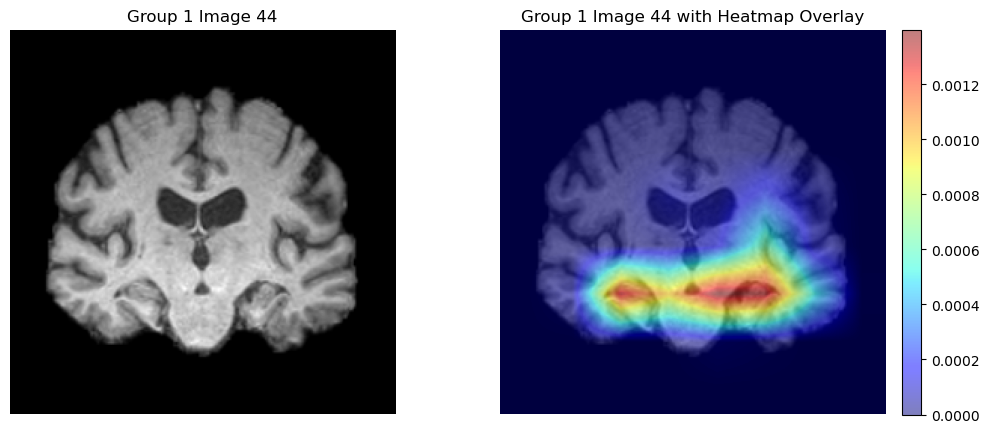

In [16]:
show_overlay(imgs=gr1_np, heatmaps=heat_gr1_rnd, idx=44, gr=1)

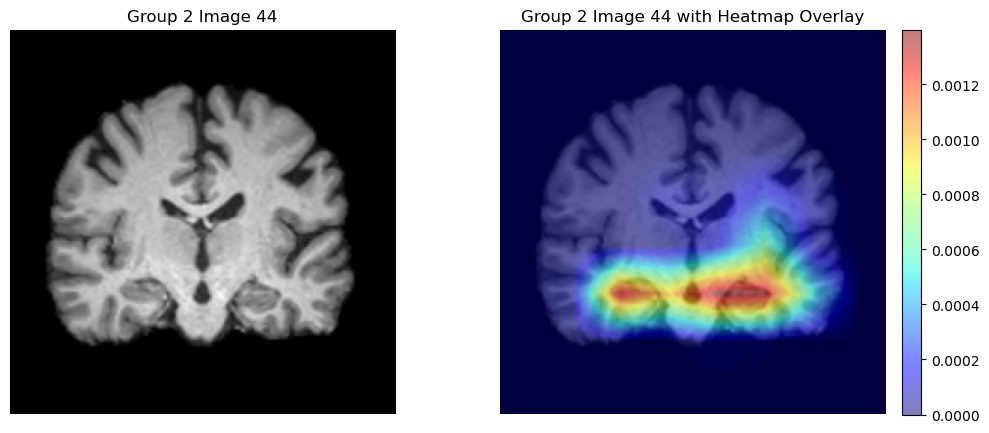

In [18]:
show_overlay(imgs=gr2_np, heatmaps=heat_gr1_rnd, idx=44, gr=2)

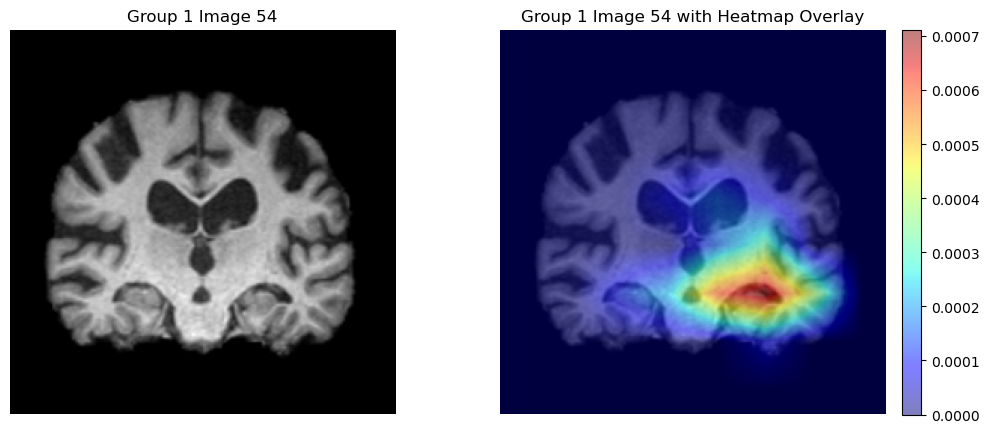

In [19]:
show_overlay(imgs=gr1_np, heatmaps=heat_gr1_rnd, idx=54, gr=1)

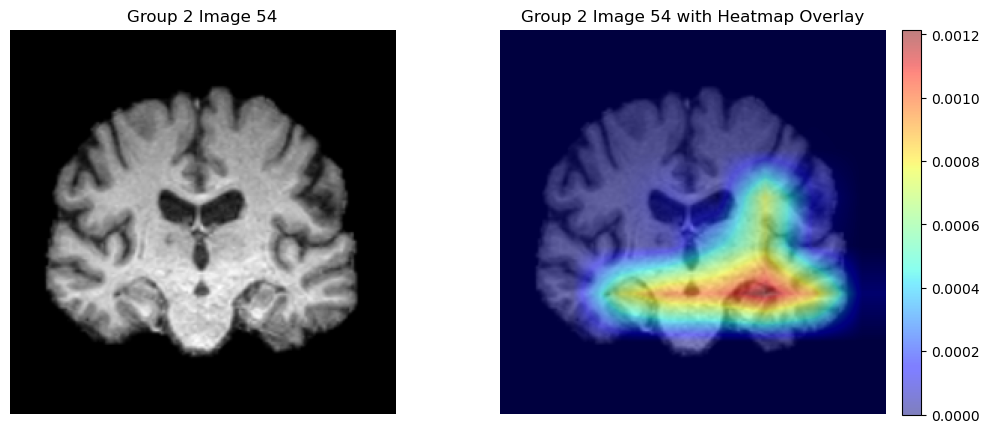

In [20]:
show_overlay(imgs=gr2_np, heatmaps=heat_gr2_rnd, idx=54, gr=2)

In [21]:
heat_gr1_20 = heat_gr1_rnd[20]
heat_gr2_20 = heat_gr2_rnd[20]

print(heat_gr1_20.shape)
print(heat_gr2_20.shape)


(256, 256)
(256, 256)


In [7]:
import numpy as np
import matplotlib.pyplot as plt

def _to_numpy_img(x):
    # Accepts NumPy or torch tensors in (H,W), (H,W,3) or (C,H,W)
    if hasattr(x, "detach"):  # torch tensor
        x = x.detach().cpu()
        if x.ndim == 3 and x.shape[0] in (1,3):  # (C,H,W) -> (H,W,C)
            x = x.permute(1, 2, 0)
        x = x.numpy()
    return x

def _normalize_hm(h):
    h = _to_numpy_img(h).squeeze()
    mn, mx = np.min(h), np.max(h)
    if mx - mn < 1e-12:
        return np.zeros_like(h)
    return (h - mn) / (mx - mn)

def show_group_grid(group1_imgs, group1_heatmaps, group2_imgs, group2_heatmaps,
                    idxs=None, alpha=0.5, cmap_hm='jet', titles=True):
    """
    idxs: list of indices to show (same indices used for all four lists);
          if None, shows up to min(len(group1_imgs), len(group2_imgs)) items.
    """
    n_available = min(len(group1_imgs), len(group1_heatmaps),
                      len(group2_imgs), len(group2_heatmaps))
    if idxs is None:
        idxs = list(range(n_available))
    else:
        idxs = [i for i in idxs if 0 <= i < n_available]
    if not idxs:
        raise ValueError("No valid indices to display.")

    n = len(idxs)
    fig, axes = plt.subplots(n, 4, figsize=(12, 3*n))
    if n == 1:  # keep indexing consistent
        axes = np.expand_dims(axes, 0)

    for r, i in enumerate(idxs):
        # --- group 1 ---
        img1 = _to_numpy_img(group1_imgs[i])
        hm1  = _normalize_hm(group1_heatmaps[i])

        axes[r, 0].imshow(img1, cmap='gray' if img1.ndim == 2 or (img1.ndim==3 and img1.shape[-1]==1) else None)
        axes[r, 0].axis('off')
        if titles: axes[r, 0].set_title(f'Group 1 — Original (idx {i})')

        axes[r, 1].imshow(img1, cmap='gray' if img1.ndim == 2 or (img1.ndim==3 and img1.shape[-1]==1) else None)
        im1 = axes[r, 1].imshow(hm1, cmap=cmap_hm, alpha=alpha)
        axes[r, 1].axis('off')
        if titles: axes[r, 1].set_title('Group 1 — Overlay')

        # --- group 2 ---
        img2 = _to_numpy_img(group2_imgs[i])
        hm2  = _normalize_hm(group2_heatmaps[i])

        axes[r, 2].imshow(img2, cmap='gray' if img2.ndim == 2 or (img2.ndim==3 and img2.shape[-1]==1) else None)
        axes[r, 2].axis('off')
        if titles: axes[r, 2].set_title(f'Group 2 — Original (idx {i})')

        axes[r, 3].imshow(img2, cmap='gray' if img2.ndim == 2 or (img2.ndim==3 and img2.shape[-1]==1) else None)
        im2 = axes[r, 3].imshow(hm2, cmap=cmap_hm, alpha=alpha)
        axes[r, 3].axis('off')
        if titles: axes[r, 3].set_title('Group 2 — Overlay')

        # Optional: per-row colorbar for the overlay (attach to col 4 to save space)
        cbar = fig.colorbar(im2, ax=axes[r, 3], fraction=0.046, pad=0.04)
        cbar.ax.tick_params(labelsize=8)

    plt.tight_layout()
    plt.show()


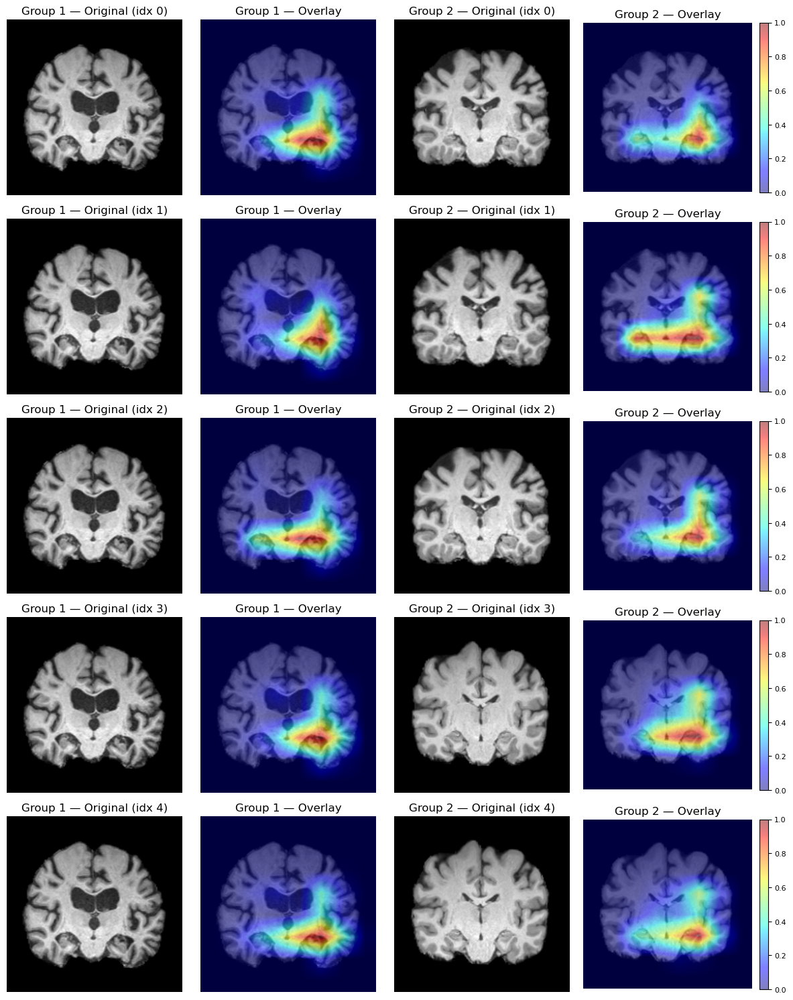

In [25]:
show_group_grid(gr1_np, heat_gr1_rnd, gr2_np, heat_gr2_rnd,
                    idxs=range(5), alpha=0.5, cmap_hm='jet', titles=True)

In [32]:
### Experimen with GradCAM++ 

# Exp: cam++-fine-tuned : 
# Expl: I used grad_cam from second implimentation (gradcam2.py)
# bs = 100
# n,m = 100 number of samples in each group
# I am using the fine-tuned model on ADNI dataset and first and second group

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 100
m1 = 100

expl = 'cam++'
exp = 'cam++-fnt'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{100}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{100}_{m1}_{expl}_{exp}.npy')
heat_gr1_cpp = np.load(path_heatmaps1)
heat_gr2_cpp = np.load(path_heatmaps2)
print(heat_gr1_cpp.shape)
print(heat_gr2_cpp.shape)

(100, 256, 256)
(100, 256, 256)


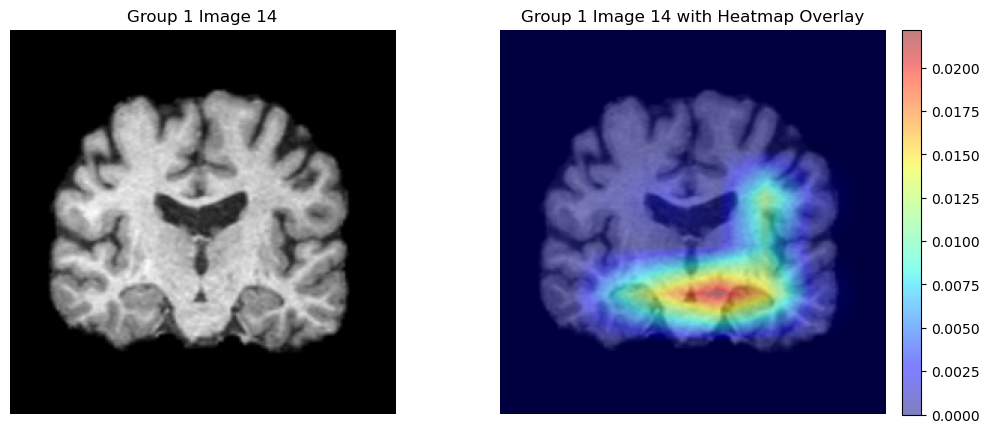

In [33]:
show_overlay(imgs=gr1_np, heatmaps=heat_gr1_cpp, idx=14, gr=1)

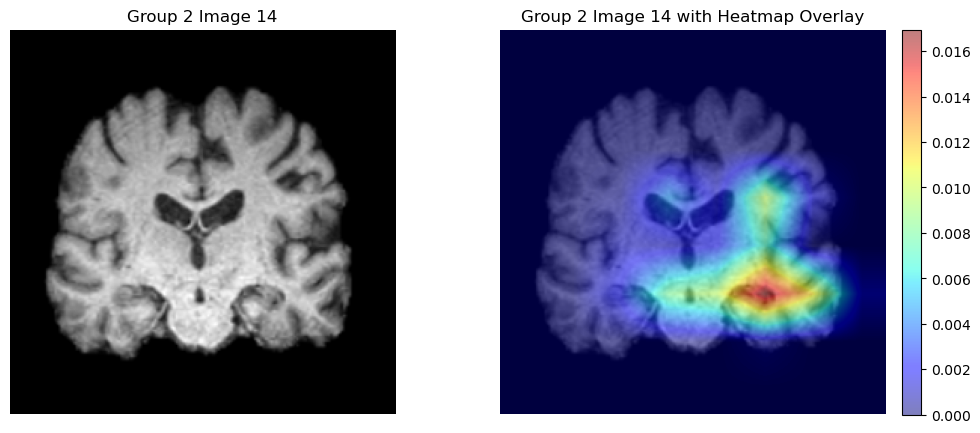

In [34]:
show_overlay(imgs=gr2_np, heatmaps=heat_gr2_cpp, idx=14, gr=2)

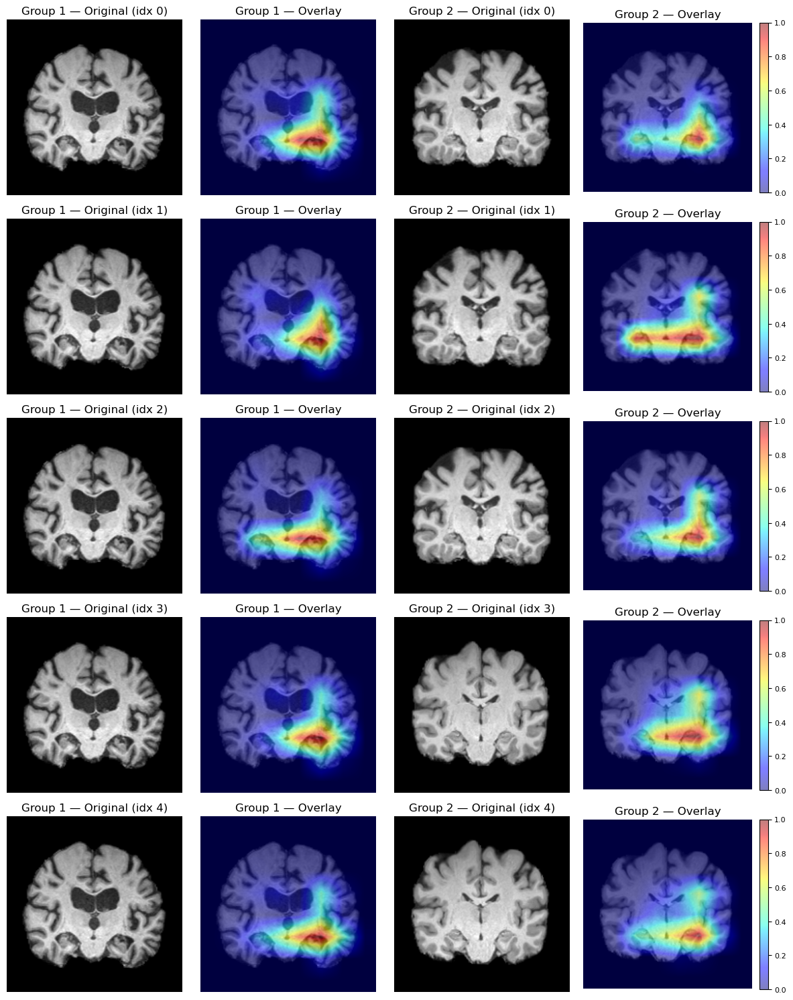

In [35]:
show_group_grid(gr1_np, heat_gr1_cpp, gr2_np, heat_gr2_cpp,
                    idxs=range(5), alpha=0.5, cmap_hm='jet', titles=True)

In [4]:
### Experimen with GradCAM

# Here I did not fine-tune the model I just used the pre-trained model on UK-Biobank 

# Exp: cam-suppr : 
# Expl: I used grad_cam from second implimentation (gradcam2.py)
# bs = 100
# n,m = 100 number of samples in each group
# I am using the fine-tuned model on ADNI dataset and first and second group

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 100
m1 = 100

expl = 'cam'
exp = 'cam-suppr'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{100}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{100}_{m1}_{expl}_{exp}.npy')
heat_gr1_supp = np.load(path_heatmaps1)
heat_gr2_supp = np.load(path_heatmaps2)
print(heat_gr1_supp.shape)
print(heat_gr2_supp.shape)

(100, 256, 256)
(100, 256, 256)


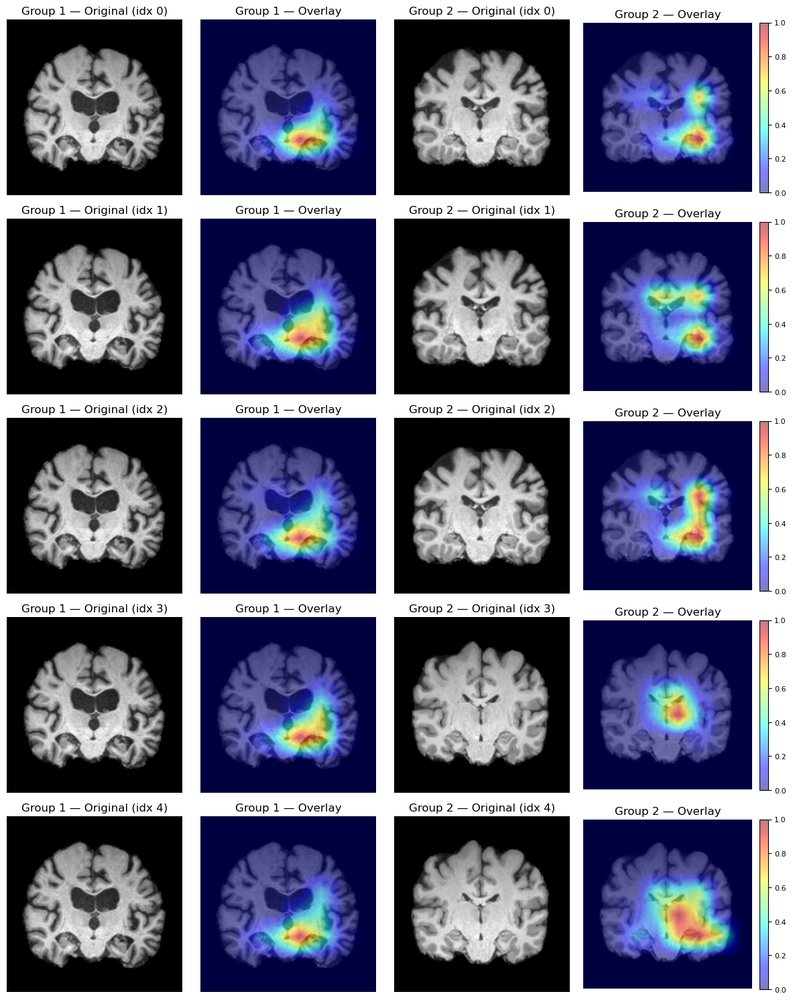

In [9]:
show_group_grid(gr1_np, heat_gr1_supp, gr2_np, heat_gr2_supp,
                    idxs=range(5), alpha=0.5, cmap_hm='jet', titles=True)

### Visualaising heatmaps on Test-set 

In [3]:
### Experimen with GradCAM and on my test-set, the EX-AI method: Grad-CAM
### Goal of experiment is to see if the results are consistent with the results on the original dataset that I used

# Exp: cam-fnt-test : 
# Expl: I used grad_cam from second implimentation (gradcam2.py)
# bs = 100
# n,m = 100 number of samples in each group
# I am using the fine-tuned model on ADNI dataset and first and second group

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 100
m1 = 100

expl = 'cam'
exp = 'cam-fnt-test'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{100}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{100}_{m1}_{expl}_{exp}.npy')
heat_gr1_fnt_test = np.load(path_heatmaps1)
heat_gr2_fnt_test = np.load(path_heatmaps2)
print(heat_gr1_fnt_test.shape)
print(heat_gr2_fnt_test.shape)

(100, 256, 256)
(100, 256, 256)


In [4]:
pwd

'/sc/home/masoumeh.javanbakhat/netstore-old/Baysian/3D/Explainability/AdniGithub/adni_results/notebook'

In [8]:
### Lets' load test-set and see overlays of heatmaps on images 
### Here I loaded original images (not normalised and not converted to tensor)
from pathlib import Path
root_dir = '../'
test_dir = Path(root_dir)/"split"/ "test" / "False"

out_path = test_dir / "test_split.npz"

with np.load(out_path, allow_pickle=False) as data:
    print(data.files)           # ['test0', 'test1']
    test0 = data['test0']       # e.g., ndarray
    test1 = data['test1']

print(test0.shape)
print(test1.shape)

['test0', 'test1']
(918, 256, 256)
(918, 256, 256)


In [9]:
test0_100 = test0[:100]

test1_100 = test1[:100]

print(test0_100.shape)
print(test1_100.shape)

(100, 256, 256)
(100, 256, 256)


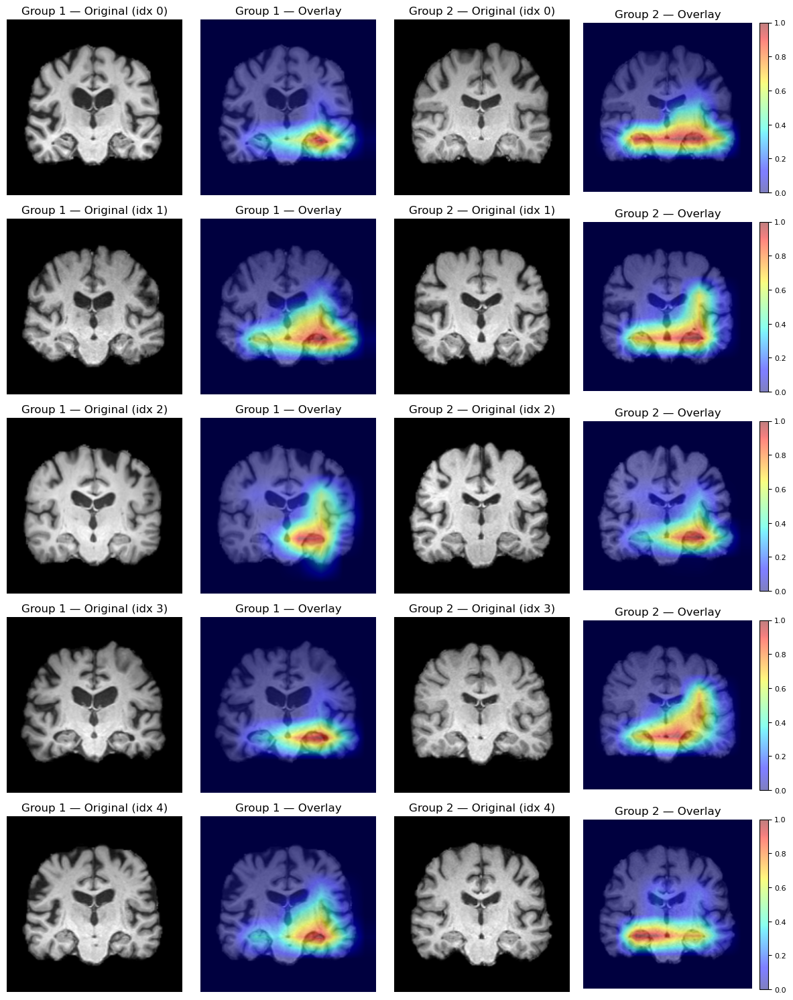

In [11]:
show_group_grid(test0_100, heat_gr1_fnt_test, test1_100, heat_gr2_fnt_test,
                    idxs=range(5), alpha=0.5, cmap_hm='jet', titles=True)

In [12]:
# Exp: cam++-fnt-test : 
# Expl: I used grad_cam from second implimentation (gradcam2.py)
# bs = 100
# n,m = 100 number of samples in each group
# I am using the fine-tuned model on ADNI dataset and first and second group

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 100
m1 = 100

expl = 'cam++'
exp = 'cam++-fnt-test'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{100}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{100}_{m1}_{expl}_{exp}.npy')
heat_gr1_fnt_test_cpp = np.load(path_heatmaps1)
heat_gr2_fnt_test_cpp = np.load(path_heatmaps2)
print(heat_gr1_fnt_test_cpp.shape)
print(heat_gr2_fnt_test_cpp.shape)

(100, 256, 256)
(100, 256, 256)


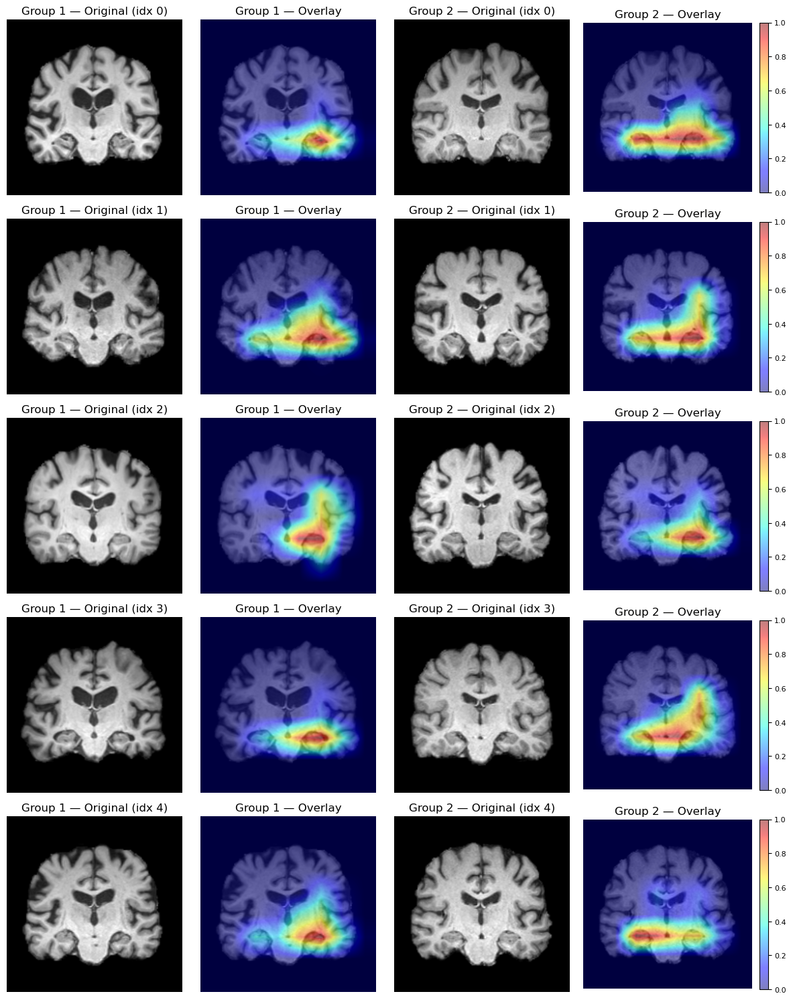

In [13]:
show_group_grid(test0_100, heat_gr1_fnt_test_cpp, test1_100, heat_gr2_fnt_test_cpp,
                    idxs=range(5), alpha=0.5, cmap_hm='jet', titles=True)

In [11]:
# Exp: lcam-fnt-test : 
# Expl: I used layercam from second implimentation (gradcam2.py)
# bs = 100
# n,m = 100 number of samples in each group
# I am using the fine-tuned model on ADNI dataset and first and second group

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 100
m1 = 100

expl = 'lcam'
exp = 'lcam-fnt-test'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{100}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{100}_{m1}_{expl}_{exp}.npy')
heat_gr1_fnt_test_lcam = np.load(path_heatmaps1)
heat_gr2_fnt_test_lcam = np.load(path_heatmaps2)
print(heat_gr1_fnt_test_lcam.shape)
print(heat_gr2_fnt_test_lcam.shape)

(100, 256, 256)
(100, 256, 256)


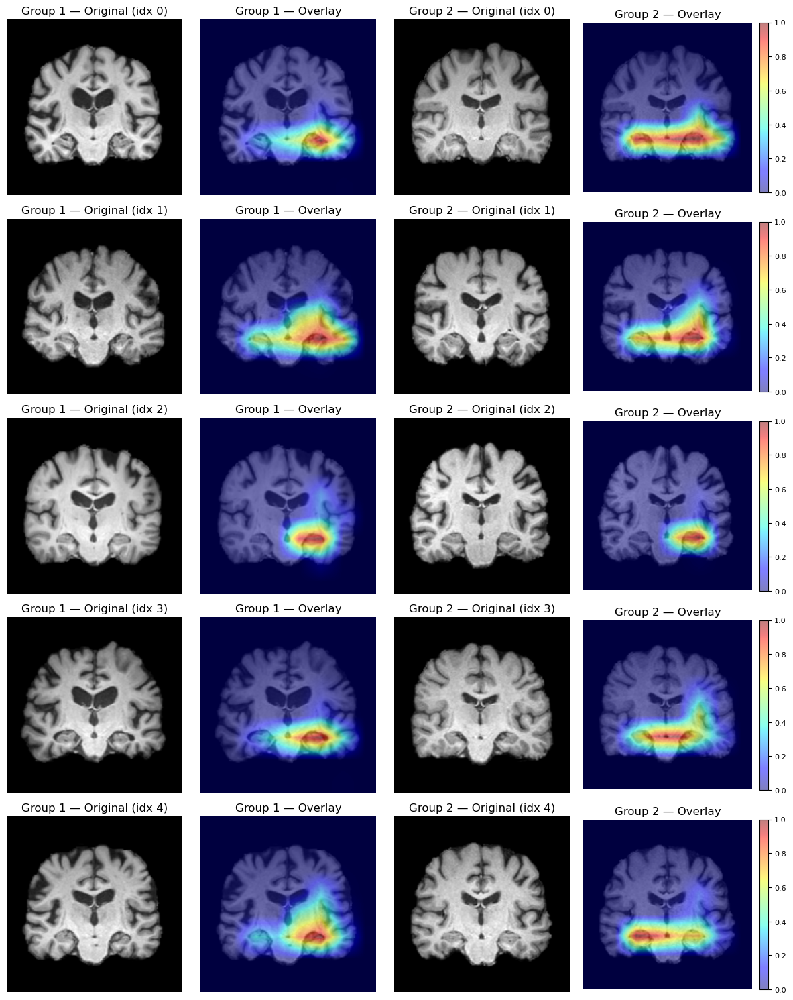

In [12]:
show_group_grid(test0_100, heat_gr1_fnt_test_lcam, test1_100, heat_gr2_fnt_test_lcam,
                    idxs=range(5), alpha=0.5, cmap_hm='jet', titles=True)

### Experiments on Test set with fine-tuned models from EXP008, 009
- Longer epochs 

In [4]:
### Lets' load test-set and see overlays of heatmaps on images 
### Here I loaded original images (not normalised and not converted to tensor)
from pathlib import Path
root_dir = '../'
test_dir = Path(root_dir)/"split"/ "test" / "False" / "None"

out_path = test_dir / "test_split.npz"

with np.load(out_path, allow_pickle=False) as data:
    print(data.files)           # ['test0', 'test1']
    test0_n = data['test0']       # e.g., ndarray
    test1_n = data['test1']

print(test0_n.shape)
print(test1_n.shape)

['test0', 'test1']
(918, 256, 256)
(918, 256, 256)


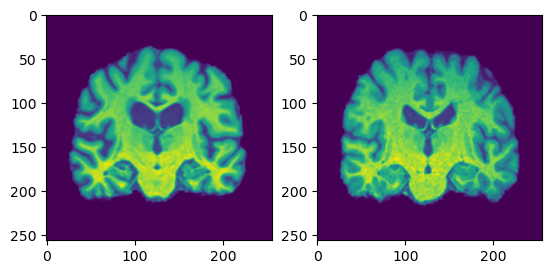

In [13]:
fig, axes = plt.subplots(1, 2)

axes[0].imshow(test0_n[0])
axes[1].imshow(test1_n[0])

In [5]:
test0_n100 = test0_n[:100]
test1_n100 = test1_n[:100]

- Note that with longer training it did not become better. Maybe beacuse we are overfitting.

In [9]:
### Experimen with GradCAM and on my test-set, the EX-AI method: Grad-CAM
### Goal of experiment is to see if the results are consistent with the results on the original dataset that I used

# Exp: cam-fnt8-uncor : 
# Expl: I used grad_cam from second implimentation (gradcam2.py)
# bs = 100
# n,m = 100 number of samples in each group
# I am using the fine-tuned model on ADNI dataset and first and second group

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 100
m1 = 100

expl = 'cam'
exp = 'cam-fnt8-uncor'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{100}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{100}_{m1}_{expl}_{exp}.npy')
heat_gr1_fnt8_test = np.load(path_heatmaps1)
heat_gr2_fnt8_test = np.load(path_heatmaps2)
print(heat_gr1_fnt8_test.shape)
print(heat_gr2_fnt8_test.shape)

(100, 256, 256)
(100, 256, 256)


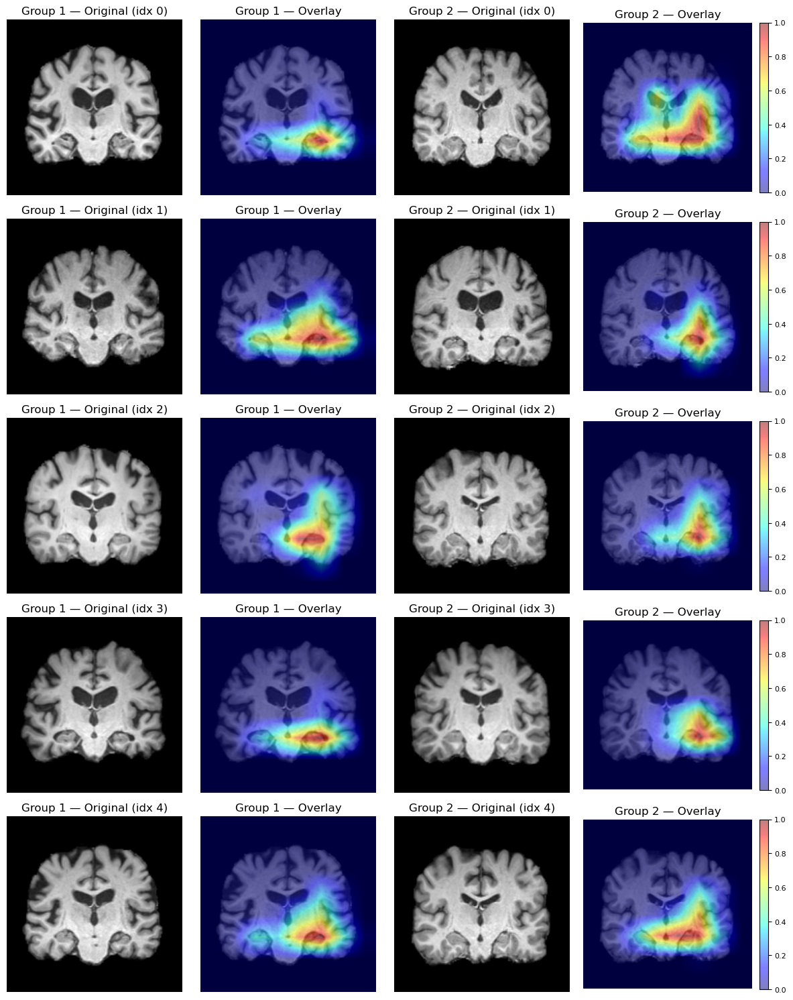

In [16]:
show_group_grid(test0_n100, heat_gr1_fnt8_test, test1_n100, heat_gr2_fnt8_test,
                    idxs=range(5), alpha=0.5, cmap_hm='jet', titles=True)

In [17]:
## Hrere I use the whole encoder that is fine-tuned instead of a model with linear probing
### Experimen with GradCAM and on my test-set, the EX-AI method: Grad-CAM
### Goal of experiment is to see if the results are consistent with the results on the original dataset that I used

# Exp: cam-fnt9-uncor : 
# Expl: I used grad_cam from second implimentation (gradcam2.py)
# bs = 100
# n,m = 100 number of samples in each group
# I am using the fine-tuned model on ADNI dataset and first and second group

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 100
m1 = 100

expl = 'cam'
exp = 'cam-fnt9-uncor'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{100}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{100}_{m1}_{expl}_{exp}.npy')
heat_gr1_fnt9_test = np.load(path_heatmaps1)
heat_gr2_fnt9_test = np.load(path_heatmaps2)
print(heat_gr1_fnt9_test.shape)
print(heat_gr2_fnt9_test.shape)


(100, 256, 256)
(100, 256, 256)


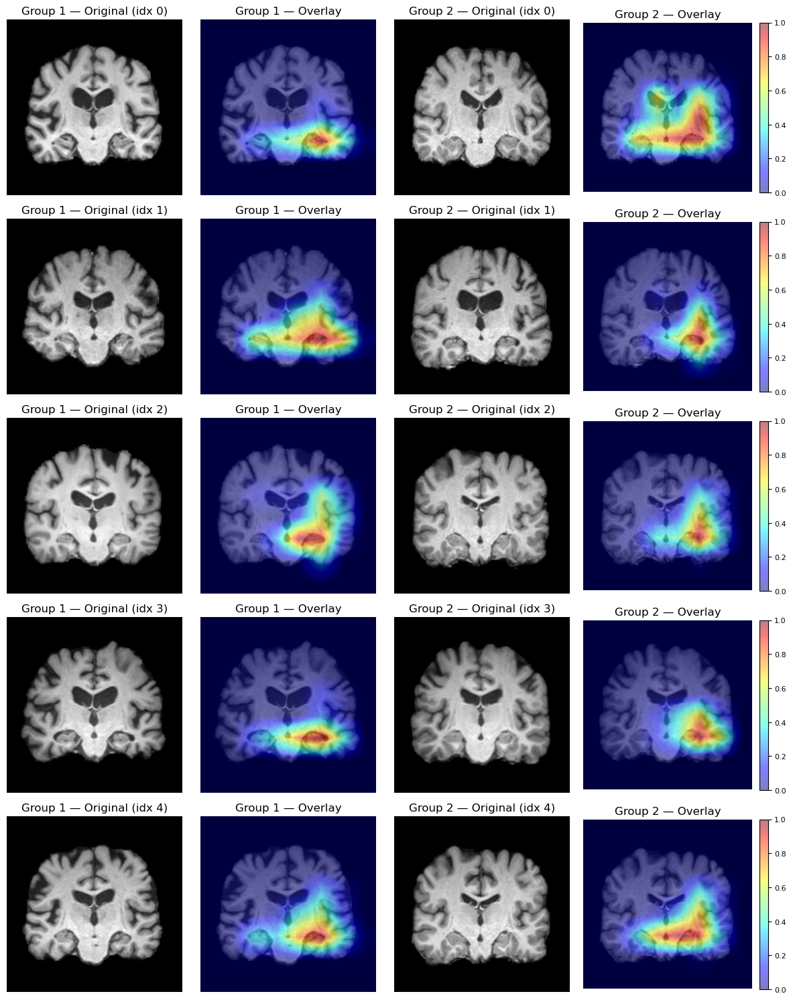

In [18]:
show_group_grid(test0_n100, heat_gr1_fnt9_test, test1_n100, heat_gr2_fnt9_test,
                    idxs=range(5), alpha=0.5, cmap_hm='jet', titles=True)

In [3]:

## Hrere I use the whole encoder that is fine-tuned instead of a model with linear probing
### Experimen with GradCAM and on my test-set, the EX-AI method: Grad-CAM
### Goal of experiment is to see if the results are consistent with the results on the original dataset that I used

# Exp: cam-fnt10-uncor : 
# Expl: I used grad_cam from second implimentation (gradcam2.py)
# bs = 100
# n,m = 100 number of samples in each group
# I am using the fine-tuned model on ADNI dataset and first and second group

import os
import numpy as np

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 100
m1 = 100

expl = 'cam'
exp = 'cam-fnt10-uncor'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{100}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{100}_{m1}_{expl}_{exp}.npy')
heat_gr1_fnt10_test = np.load(path_heatmaps1)
heat_gr2_fnt10_test = np.load(path_heatmaps2)
print(heat_gr1_fnt10_test.shape)
print(heat_gr2_fnt10_test.shape)


(100, 256, 256)
(100, 256, 256)


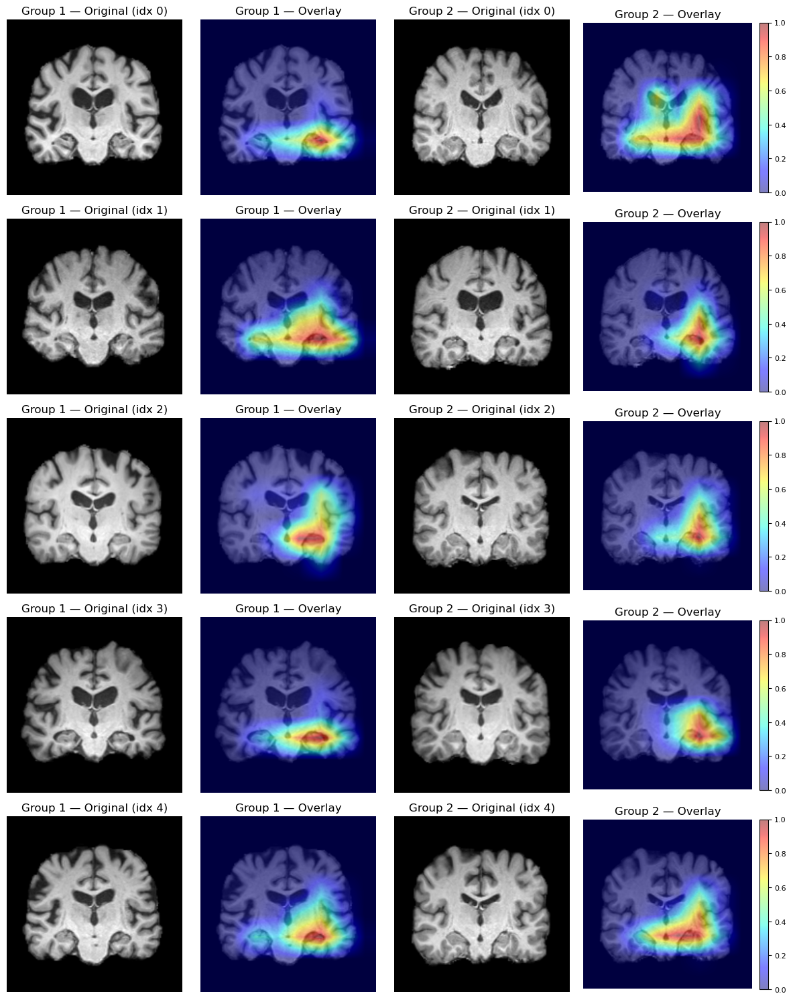

In [8]:
show_group_grid(test0_n100, heat_gr1_fnt10_test, test1_n100, heat_gr2_fnt10_test,
                    idxs=range(5), alpha=0.5, cmap_hm='jet', titles=True)

### Occlusion maps

In [ ]:
import torch.nn.functional as F

def occlusion_map(forward_fn, x, patch=16, stride=8, baseline_value=0.0):
    """
    Returns an importance map per image, same HxW as input (upsampled if needed).
    Measures drop in scalar when patch is masked (bigger drop => more important).
    """
    B, C, H, W = x.shape
    with torch.no_grad():
        base = forward_fn(x).detach()  # (B,)
    imp = torch.zeros(B, 1, (H - patch)//stride + 1, (W - patch)//stride + 1, device=x.device)

    for i, yy in enumerate(range(0, H - patch + 1, stride)):
        for j, xx in enumerate(range(0, W - patch + 1, stride)):
            x_mask = x.clone()
            x_mask[:, :, yy:yy+patch, xx:xx+patch] = baseline_value
            with torch.no_grad():
                y = forward_fn(x_mask)
            drop = (base - y).clamp_min(0)  # if you expect drops; or keep signed
            imp[:, 0, i, j] = drop

    # upsample to input resolution
    return F.interpolate(imp, size=(H, W), mode='bilinear', align_corners=False)


## Group Control

- Below I look at corrupted images and their corresponding heatmaps 
- I tried two versions of GradCAM, here I use GradCAM++ too. 

- When I have two identical group (group1, group1), p-value is 1. 
- Below expeiments show test-statitic is sensitive to degree of corruption 

- Corruption shows increase in test-statistic but it fails generate menaingful heatmpas. Here is the resaon:

   - Grad-CAM fails because the model’s filters weren’t trained to interpret large zero patches → gradients don’t highlight them reliably. So you see the paradox: statistic ↑ (math is fine), CAMs = garbage.

|  Exp     | Expl     | test_stat|two_groups|
|----------|----------|----------|----------|
| cam_cor4 |cam(first)| 2.4329   |gr1,gr1co4|
| cam_cor4 |cam(scnd) | 2.4329   |gr1,gr1co4|
|cam++cor4 |cam++     | 2.4329   |gr1,gr1co4|
|cam++cor5 |cam++     | 2.6323   |gr1,gr1co5|
|cam++cor6 |cam++     | 2.8768   |gr1,gr1co6|


|  Exp     | Expl     | test_stat|two_groups|      |
|----------|----------|----------|----------|------|
|cam       | cam      | 0.0000   |gr1, gr1  |      |
|cam_bl5    |cam       | 0.7685  |gr1,gr1bl5|      |
|cam_bl6    |cam       | 1.0649  |gr1,gr1bl6|0.8766|
|cam_bl7    |cam       | 1.4207  |gr1,gr1bl7|      |

In [24]:
# Load currupted images 
from pathlib import Path
ADNI_CORR = Path("/sc/home/masoumeh.javanbakhat/netstore-old/Baysian/3D/Explainability/Retina_Codes/adni_corrupted")
path_corrupted6 = os.path.join(ADNI_CORR, 'group1_masked_64_6.npy')

gr1_msk6 = np.load(path_corrupted6)

In [19]:
# Exp: Control group: 
# Expl: I used grad_cam first from my implimentation (gradcam.py)
# bs = 64
# n,m = 64 number of samples in each group
# in the second group I used corrupted images with 4% of most importnat features removed

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 64
m1 = 64

expl = 'cam'
exp = 'cam_first_cor4'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{64}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{64}_{m1}_{expl}_{exp}.npy')
heat_gr1_cor = np.load(path_heatmaps1)
heat_gr2_cor = np.load(path_heatmaps2)
print(heat_gr1_cor.shape)
print(heat_gr2_cor.shape)

(64, 256, 256)
(64, 256, 256)


In [20]:
print(np.max(heat_gr1_cor), np.min(heat_gr1_cor))
print(np.max(heat_gr2_cor), np.min(heat_gr2_cor))


5.0284586 0.0
5.048098 0.0


- All of the heatmaps from second group are zero (empty heatmaps)

In [21]:
non_zero_heat_gr1 = []
for i in range(len(heat_gr1_cor)):
    if np.any(heat_gr1_cor[i] != 0):
        non_zero_heat_gr1.append([i,heat_gr1_cor[i]])


non_zero_idx_gr1 = [ id for id, heat in non_zero_heat_gr1]

print(non_zero_idx_gr1)

[14, 15, 17, 20, 21, 22, 23, 24, 25, 26, 27, 29, 30, 37, 40, 45, 62]


In [22]:
# Non zero heatmaps for group 1 masked with 4% features
non_zero_heat_gr1_masked = []
for i in range(len(heat_gr2_cor)):
    if np.any(heat_gr2_cor[i] != 0):
        non_zero_heat_gr1.append([i,heat_gr2_cor[i]])

non_zero_idx_gr2 = [ id for id, heat in non_zero_heat_gr1_masked]
print(non_zero_heat_gr1_masked)

[]


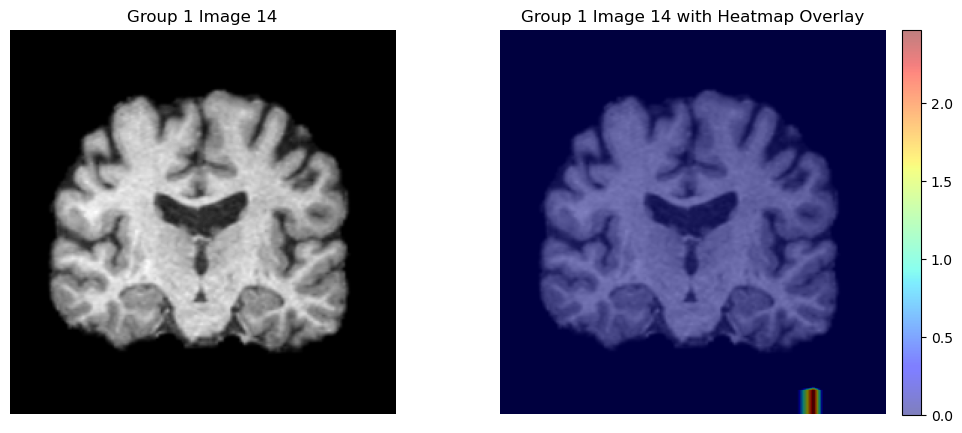

In [23]:
## Looking at some non-zero heatmaps from gr1

show_overlay(imgs=gr1_np, heatmaps=heat_gr1_cor, idx=14, gr=1)

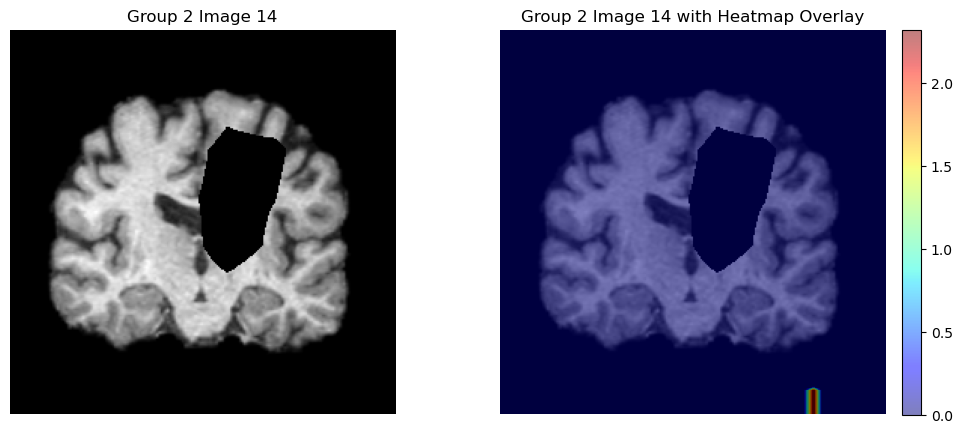

In [25]:
show_overlay(imgs=gr1_msk6, heatmaps=heat_gr2_cor, idx=14, gr=2)

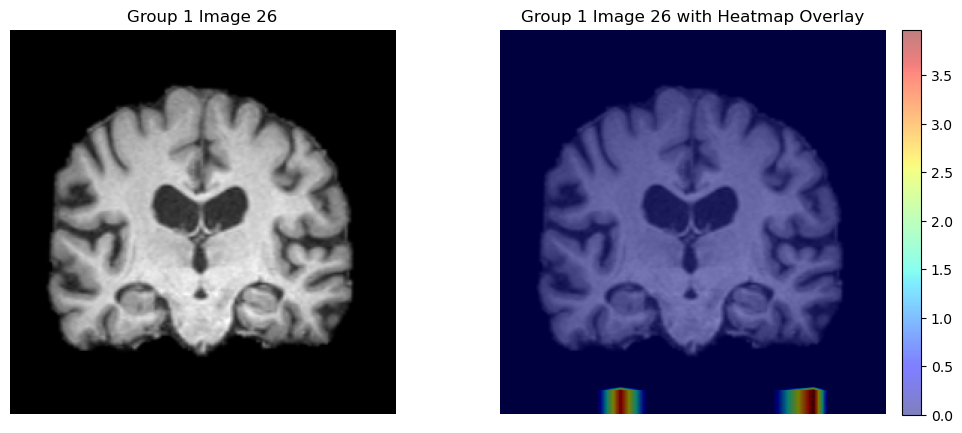

In [26]:
show_overlay(imgs=gr1_np, heatmaps=heat_gr1_cor, idx=26, gr=1)

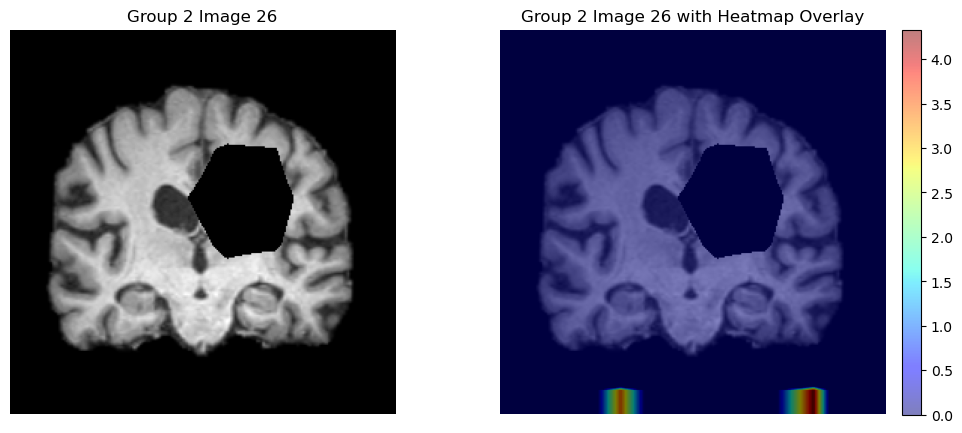

In [27]:
show_overlay(imgs=gr1_msk6, heatmaps=heat_gr2_cor, idx=26, gr=2)

In [56]:
# Expl: I used grad_cam first from implimentation of chatGPT (gradcam2.py)
# bs = 64
# n,m = 64 number of samples in each group
# in the second group I used corrupted images with 4% of most importnat features removed

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 64
m1 = 64

expl = 'cam'
exp = 'cam_scd_cor4'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{64}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{64}_{m1}_{expl}_{exp}.npy')
heat_gr1_cor_scd = np.load(path_heatmaps1)
heat_gr2_cor_scd = np.load(path_heatmaps2)
print(heat_gr1_cor_scd.shape)
print(heat_gr2_cor_scd.shape)

(64, 256, 256)
(64, 256, 256)


In [57]:
print(np.max(heat_gr1_cor_scd), np.min(heat_gr1_cor_scd))
print(np.max(heat_gr2_cor_scd), np.min(heat_gr2_cor_scd))

6.618772e-05 0.0
6.6448716e-05 0.0


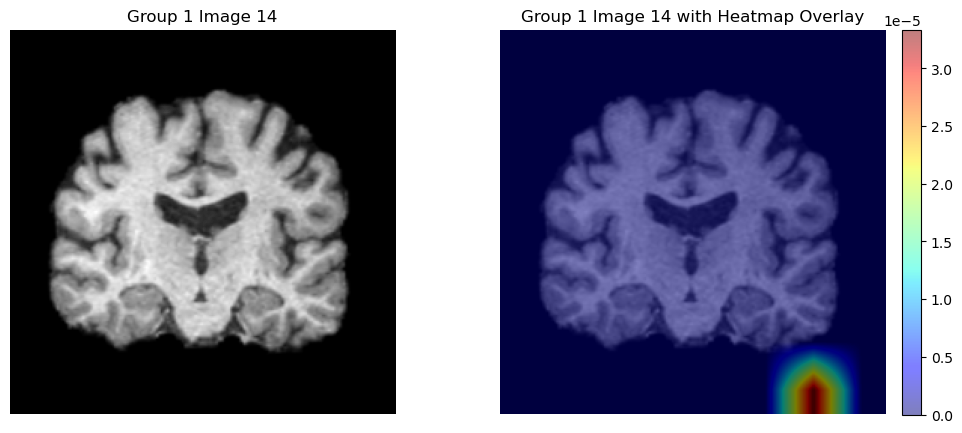

In [58]:
show_overlay(imgs=gr1_np, heatmaps=heat_gr1_cor_scd, idx=14, gr=1)

- Signals in group2 are noe zero when I sue GradCAM++

In [28]:
# Exp: Control group: 
# Expl: I used grad_cam++ from second implimentation (gradcam2.py)
# bs = 64
# n,m = 64 number of samples in each group
# in the second group I used corrupted images with 4% of most importnat features removed
# below it shows that we have stronger singnal in the heatmaps

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 64
m1 = 64

expl = 'cam++'
exp = 'cam++_cor4'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{64}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{64}_{m1}_{expl}_{exp}.npy')
heat_gr1_cor_campp = np.load(path_heatmaps1)
heat_gr2_cor_campp = np.load(path_heatmaps2)
print(heat_gr1_cor_campp.shape)
print(heat_gr2_cor_campp.shape)

(64, 256, 256)
(64, 256, 256)


In [7]:
print(np.max(heat_gr1_cor_campp), np.min(heat_gr1_cor_campp))
print(np.max(heat_gr2_cor_campp), np.min(heat_gr2_cor_campp))

0.0013766945 0.0
0.0013791762 0.0


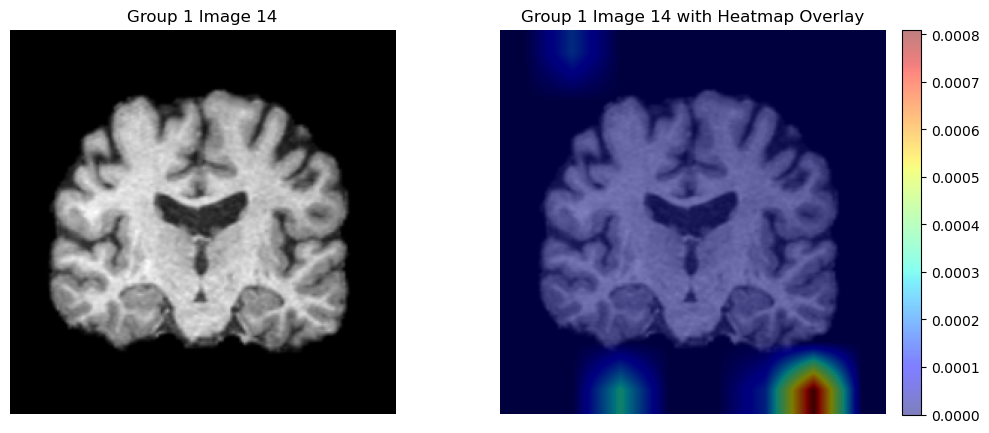

In [29]:
show_overlay(imgs=gr1_np, heatmaps=heat_gr1_cor_campp, idx=14, gr=1)

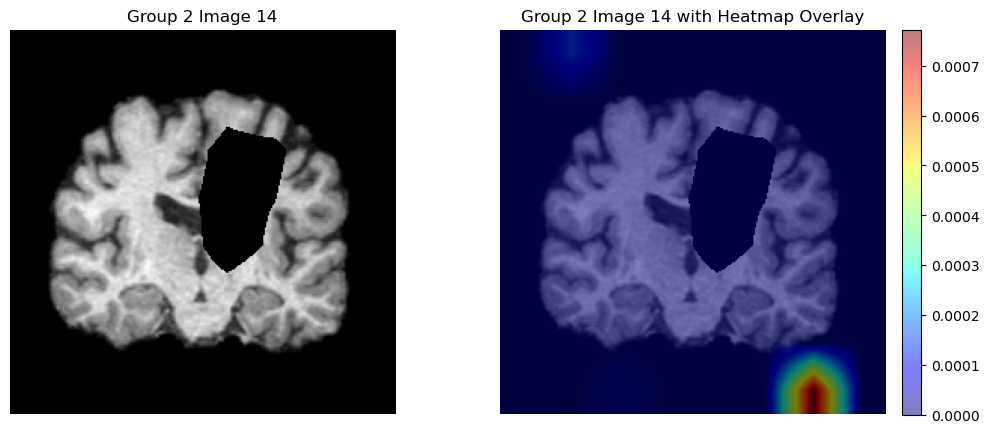

In [30]:
show_overlay(imgs=gr1_msk6, heatmaps=heat_gr2_cor_campp, idx=14, gr=2)

In [33]:
# Non zero heatmaps for group 1 masked with 4% features
non_zero_heat_gr2_masked = []
for i in range(len(heat_gr2_cor_campp)):
    if np.any(heat_gr2_cor_campp[i] != 0):
        non_zero_heat_gr2_masked.append([i,heat_gr2_cor_campp[i]])

non_zero_idx_gr2 = [ id for id, heat in non_zero_heat_gr2_masked]
print(len(non_zero_heat_gr2_masked))

63


In [35]:
# Here I should load images with blured regions 
ADNI_CORR = Path("/sc/home/masoumeh.javanbakhat/netstore-old/Baysian/3D/Explainability/Retina_Codes/adni_blured")
path_bl = os.path.join(ADNI_CORR, 'group1_blured_64_5.npy')
blured6 = np.load(path_bl)

In [11]:
# Exp: Control group: 
# Expl: I used grad_cam++ from second implimentation (gradcam2.py)
# bs = 64
# n,m = 64 number of samples in each group
# in the second group I used blured images with 6% of most importnat features blured


base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 64
m1 = 64

expl = 'cam++'
exp = 'cam++_bl6'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{64}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{64}_{m1}_{expl}_{exp}.npy')
heat_gr1_bl6_campp = np.load(path_heatmaps1)
heat_gr2_bl6_campp = np.load(path_heatmaps2)
print(heat_gr1_bl6_campp.shape)
print(heat_gr2_bl6_campp.shape)

(64, 256, 256)
(64, 256, 256)


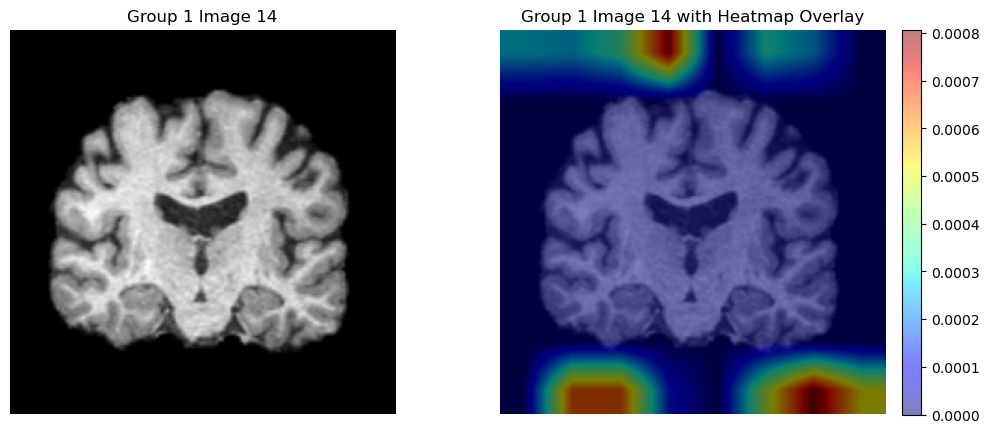

In [13]:
show_overlay(imgs=gr1_np, heatmaps=heat_gr1_bl6_campp, idx=14, gr=1)

In [17]:
# Non zero heatmaps for group 1 masked with 4% features
non_zero_heat_gr2_bl6 = []
for i in range(len(heat_gr2_bl6_campp)):
    if np.any(heat_gr2_bl6_campp[i] != 0):
        non_zero_heat_gr2_bl6.append([i,heat_gr2_bl6_campp[i]])

non_zero_idx_gr2 = [ id for id, heat in non_zero_heat_gr2_bl6]
print(non_zero_idx_gr2)

print(len(non_zero_idx_gr2))

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63]
64


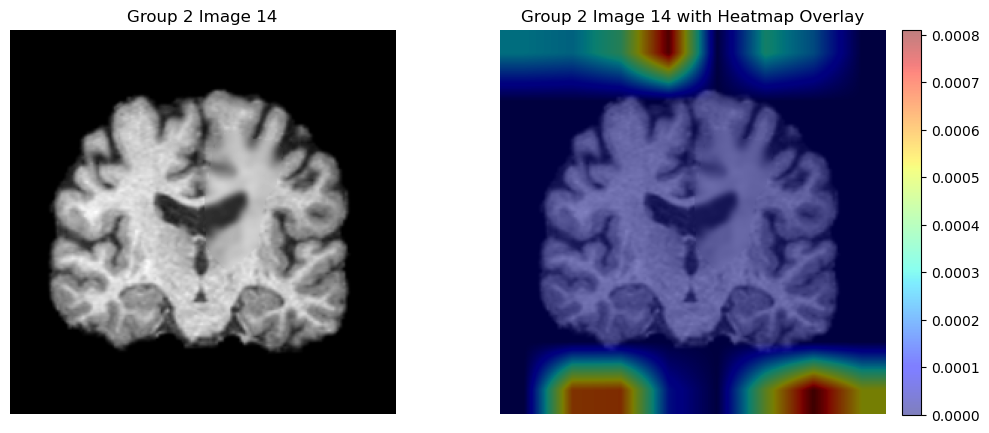

In [38]:
show_overlay(imgs=blured6, heatmaps=heat_gr2_bl6_campp, idx=14, gr=2)

### Experiment with controlled group while I fine-tuned the model on corrupted images 

In [15]:
# Exp: cam-fnt-blur-test : 
# Expl: I used cam from second implimentation (gradcam2.py)
# bs = 100
# n,m = 100 number of samples in each group
# I am using the fine-tuned model on ADNI dataset and first and second group

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 100
m1 = 100

expl = 'cam'
exp = 'cam-fnt-test-bl'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{100}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{100}_{m1}_{expl}_{exp}.npy')
heat_gr1_fnt_test_bl = np.load(path_heatmaps1)
heat_gr2_fnt_test_bl = np.load(path_heatmaps2)
print(heat_gr1_fnt_test_bl.shape)
print(heat_gr2_fnt_test_bl.shape)

(100, 256, 256)
(100, 256, 256)


In [16]:
# Load test set corrupted with blur images 

### Here I loaded original images (not normalised and not converted to tensor)
from pathlib import Path
root_dir = '../'
test_dir = Path(root_dir)/"split"/ "test" / "True"

out_path = test_dir / "test_split.npz"

with np.load(out_path, allow_pickle=False) as data:
    print(data.files)           # ['test0', 'test1']
    test0_bl = data['test0']       # e.g., ndarray
    test1_bl = data['test1']

print(test0_bl.shape)
print(test1_bl.shape)

['test0', 'test1']
(918, 256, 256)
(918, 256, 256)


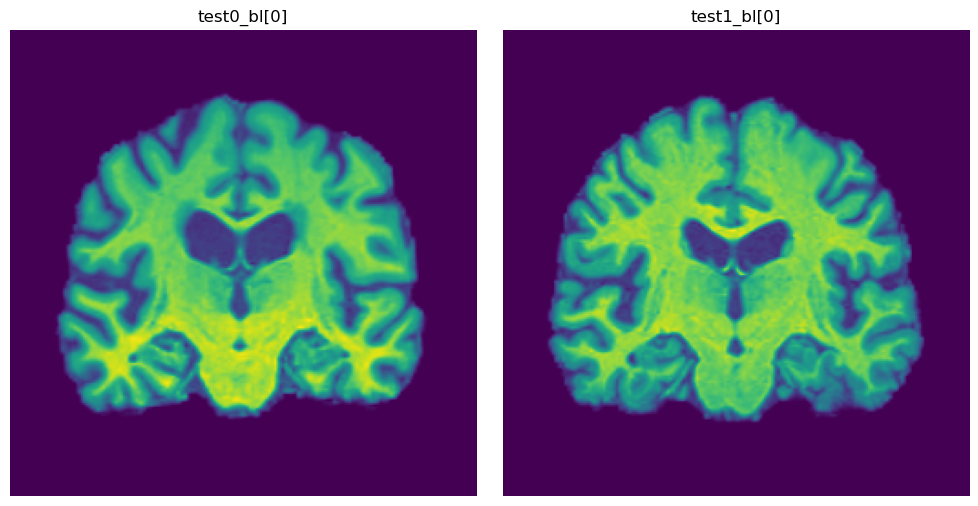

In [20]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 2, figsize=(10, 5))
axes[0].imshow(test0_bl[0]); axes[0].axis("off"); axes[0].set_title("test0_bl[0]")
axes[1].imshow(test1_bl[0]); axes[1].axis("off"); axes[1].set_title("test1_bl[0]")
plt.tight_layout()
plt.show()

In [17]:
test0_bl_100 = test0_bl[:100]
test1_bl_100 = test1_bl[:100]

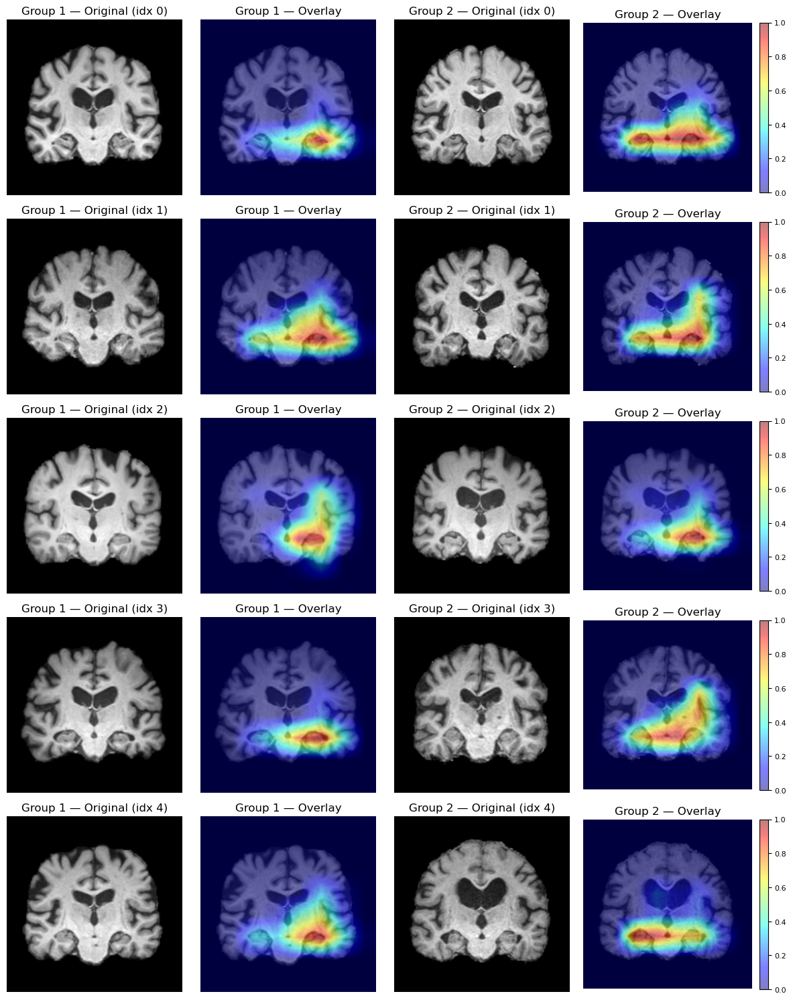

In [18]:
show_group_grid(test0_bl_100, heat_gr1_fnt_test_bl, test1_bl_100, heat_gr2_fnt_test_bl,
                    idxs=range(5), alpha=0.5, cmap_hm='jet', titles=True)

### Visualisability of corrupted images in the datset

- Here I try to visualaise imeges that I corrupetd previously to see if dataset itself has been created correctly 

In [2]:
# Load test set corrupted with blur images 
### Here I loaded original images (not normalised and not converted to tensor)
from pathlib import Path
import numpy as np
root_dir = '../'
test_dir = Path(root_dir)/"split"/ "test" / "True"

out_path = test_dir / "test_split.npz"

with np.load(out_path, allow_pickle=False) as data:
    print(data.files)           # ['test0', 'test1']
    test0_bl = data['test0']       # e.g., ndarray
    test1_bl = data['test1']

print(test0_bl.shape)
print(test1_bl.shape)

['test0', 'test1']
(918, 256, 256)
(918, 256, 256)


In [3]:
import numpy as np
import matplotlib.pyplot as plt

def to_display(img):
    """Ensure image is displayable: (H,W) -> (H,W,3), normalize if needed."""
    arr = np.asarray(img)
    # Convert grayscale to 3-channel
    if arr.ndim == 2:
        arr = np.stack([arr, arr, arr], axis=-1)
    # If values look like not in [0,1], try to scale to [0,1]
    if arr.dtype != np.uint8 and (arr.min() < 0 or arr.max() > 1.0):
        arr = (arr - arr.min()) / (arr.max() - arr.min() + 1e-8)
    return arr

def show_two_groups_side_by_side(group1, group2, n_rows=5, titles=("Group 1", "Group 2"), figsize=(6, 12)):
    """
    group1, group2: lists/arrays of images as NumPy arrays (H×W or H×W×C).
    n_rows: how many rows to show (will truncate to the shortest group).
    """
    n = min(n_rows, len(group1), len(group2))
    fig, axes = plt.subplots(n, 2, figsize=figsize)
    # If n == 1, axes comes back as 1D; make it 2D for consistency
    if n == 1:
        axes = np.array([axes])

    for i in range(n):
        axes[i, 0].imshow(to_display(group1[i]), interpolation="nearest")
        axes[i, 0].set_axis_off()
        if i == 0:
            axes[i, 0].set_title(f"{titles[0]}")

        axes[i, 1].imshow(to_display(group2[i]), interpolation="nearest")
        axes[i, 1].set_axis_off()
        if i == 0:
            axes[i, 1].set_title(f"{titles[1]}")

    plt.tight_layout()
    plt.show()

# Example usage:
# show_two_groups_side_by_side(group1_arrays, group2_arrays, n_rows=5)


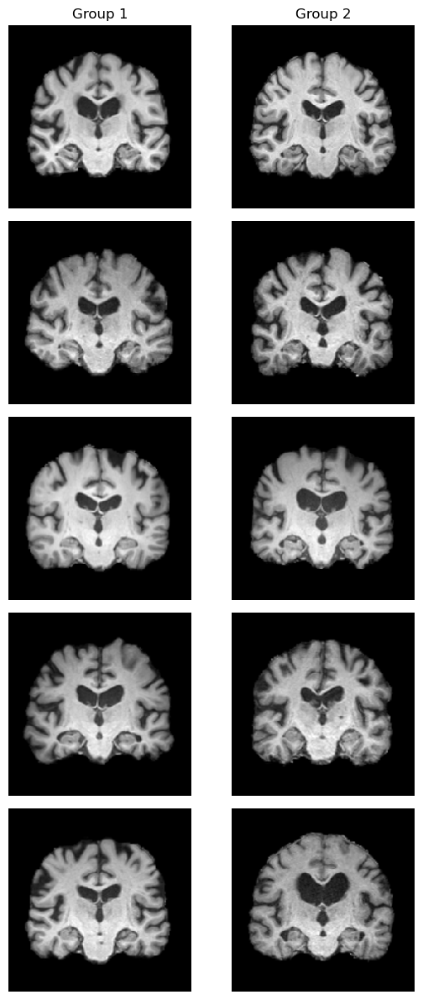

In [4]:
show_two_groups_side_by_side(test0_bl, test1_bl, n_rows=5, titles=("Group 1", "Group 2"), figsize=(6, 12))

In [8]:
import os

root_dir = '/sc/home/masoumeh.javanbakhat/netstore-old/Baysian/3D/Explainability'
gr0_dir = os.path.join(root_dir, 'AdniGithub','adni_results','images', f'gr0_4591.npy')
gr1_corrupted_dir = os.path.join(root_dir, 'AdniGithub','adni_results','corrupted', f'gr0_4591_blur_ps32_sigma0.8.npz')
gr0 = np.load(gr0_dir)
data = np.load(gr1_corrupted_dir)
gr1 = data['image']
print(gr0.shape)

print(gr1.shape)

: 

In [8]:
gr0_img0 = gr0[0]

gr1_img0 = gr1[0]

print(gr0_img0.shape)



(256, 256)


In [5]:
import matplotlib.pyplot as plt

def show_side_by_side(img1, img2, titles=("Image 1", "Image 2"), figsize=(8,4)):
    fig, axes = plt.subplots(1, 2, figsize=figsize)
    axes[0].imshow(img1)
    axes[0].set_title(titles[0]); axes[0].axis("off")

    axes[1].imshow(img2)
    axes[1].set_title(titles[1]); axes[1].axis("off")

    plt.tight_layout()
    plt.show()

show_side_by_side(gr0_img0, gr1_img0)


NameError: name 'gr0_img0' is not defined

In [11]:
np.array_equal(gr0_img0, gr1_img0, equal_nan=True)

False

In [1]:
### Lets' look at images with zeroing out squares 

import os
import numpy as np
root_dir = '/sc/home/masoumeh.javanbakhat/netstore-old/Baysian/3D/Explainability'
print('Using corrupted images with zeroing with ps=32 for group 1')
gr0_dir = os.path.join(root_dir, 'AdniGithub','adni_results','images', f'gr0_4591.npy')
gr1_corrupted_dir = os.path.join(root_dir, 'AdniGithub','adni_results','corrupted', f'gr0_4591_zero_ps32_sigma0.8.npz')
gr0 = np.load(gr0_dir)
data = np.load(gr1_corrupted_dir)
gr1 = data['image']

Using corrupted images with zeroing with ps=32 for group 1


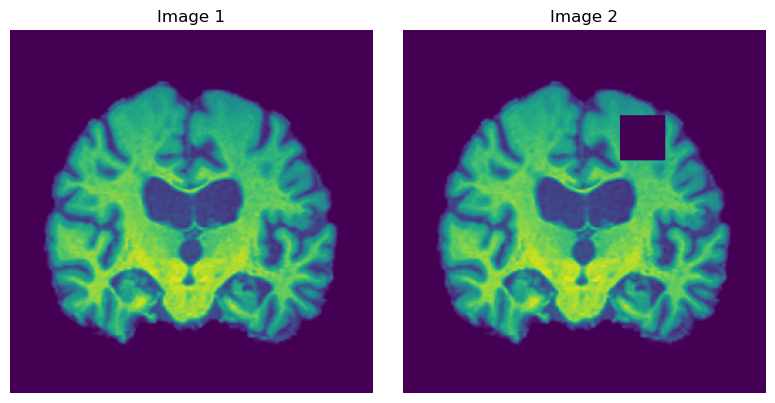

In [7]:
gr0_imgzer = gr0[0]

gr1_imgzer = gr1[0]


show_side_by_side(gr0_imgzer, gr1_imgzer)



In [33]:
### Now lets check if train, val  and test sets are built correctly 

# Let's check train, val and test sets 
# 

from pathlib import Path 
import numpy as np
import pandas as pd

root_dir = '/sc/home/masoumeh.javanbakhat/netstore-old/Baysian/3D/Explainability'
train_dir = Path(root_dir) / "AdniGithub"/ "adni_results" / "split" / "train" / "True" / "zer32" 

out_path = train_dir / "train_val_splits.npz"

with np.load(out_path) as data:
    print(list(data.keys()))          # ['X_train', 'y_train', 'X_val', 'y_val']
    X_train = data["X_train"]
    y_train = data["y_train"]
    X_val   = data["X_val"]
    y_val   = data["y_val"]

print(X_train.shape)

['X_train', 'y_train', 'X_val', 'y_val']
(5510, 256, 256)


In [34]:
print(type(X_train))

print(X_train.shape)

<class 'numpy.ndarray'>
(5510, 256, 256)


In [35]:
x0_tr = X_train[0]

print(x0.shape)

x0_val = X_val[0]

print(x0_val.shape)

(256, 256)
(256, 256)


In [36]:
print(y_train.shape)

print(type(y_train))

# let's look at labels of y_train
labels_tr = np.unique(y_train)

print(labels_tr)

## Let's seperate groups based on labels and visualise images
gr0_tr = X_train[y_train==0]
gr1_tr = X_train[y_train==1]

print(gr0_tr.shape)

print(gr1_tr.shape)

img_h_gr0 = gr0_tr[0]

img_un_gr1 = gr1_tr[0]

(5510,)
<class 'numpy.ndarray'>
[0 1]
(2755, 256, 256)
(2755, 256, 256)


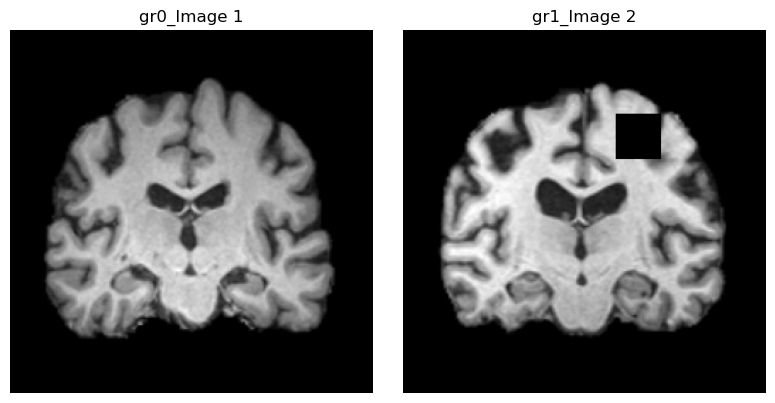

In [37]:
fig, axes = plt.subplots(1, 2, figsize=(8, 4))
axes[0].imshow(img_h_gr0, cmap="gray")
axes[0].set_title("gr0_Image 1"); axes[0].axis("off")

axes[1].imshow(img_un_gr1, cmap="gray")
axes[1].set_title("gr1_Image 2"); axes[1].axis("off")

plt.tight_layout()
plt.show()

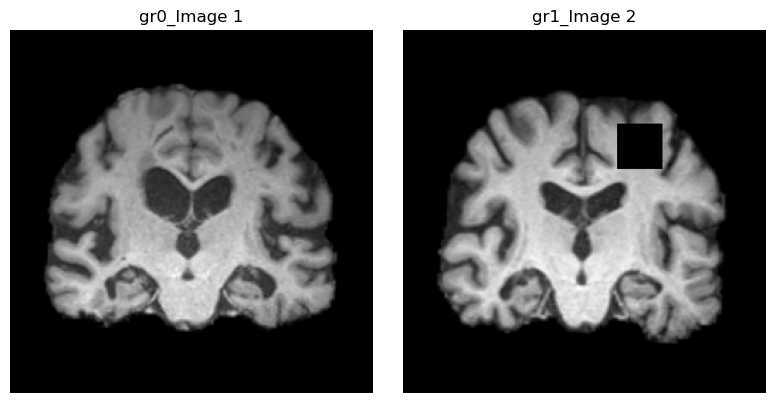

In [20]:
## Let's look at two other images 

img_h1_gr0 = gr0_tr[1]

img_un1_gr1 = gr1_tr[1]

fig, axes = plt.subplots(1, 2, figsize=(8, 4))
axes[0].imshow(img_h1_gr0, cmap="gray")
axes[0].set_title("gr0_Image 1"); axes[0].axis("off")

axes[1].imshow(img_un1_gr1, cmap="gray")
axes[1].set_title("gr1_Image 2"); axes[1].axis("off")

plt.tight_layout()
plt.show()

In [4]:
### Let's check test set as well
### Now we look at test_dir 
root_dir = '/sc/home/masoumeh.javanbakhat/netstore-old/Baysian/3D/Explainability'

test_dir = Path(root_dir) / "AdniGithub" /"adni_results" /"split"/ "test" / "True" / "zer32"
# Save both arrays into a single compressed file
out_path = test_dir / "test_split.npz"

# Load (dict-like object). Use a context manager to close the file handle.
with np.load(out_path, allow_pickle=False) as data:
    print("Keys:", list(data.keys()))   # -> ['test0', 'test1']
    test0 = data["test0"]
    test1 = data["test1"]

print(test0.shape, test0.dtype)
print(test1.shape, test1.dtype)


Keys: ['test0', 'test1']
(918, 256, 256) uint8
(918, 256, 256) float32


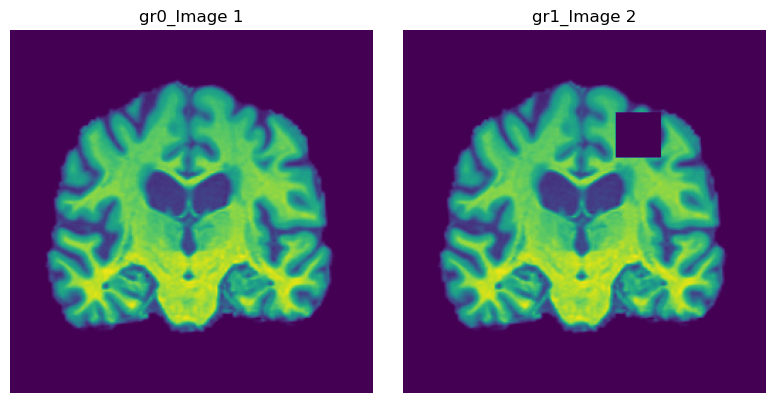

In [39]:
### lets visualise some images from test0 and test1
img0_test0 = test0[0]

img0_test1 = test1[0]

fig, axes = plt.subplots(1, 2, figsize=(8, 4))
axes[0].imshow(img0_test0)
axes[0].set_title("gr0_Image 1"); axes[0].axis("off")

axes[1].imshow(img0_test1)
axes[1].set_title("gr1_Image 2"); axes[1].axis("off")

plt.tight_layout()
plt.show()

- Now it shows corrupted images for test-set correctly like paired.

In [5]:
test0_zer32 = test0[:100]
test1_zer32 = test1[:100]

In [10]:
# Exp: cam-fnt-test-zer : 
# Expl: I used cam from second implimentation (gradcam2.py)
# bs = 100
# n,m = 100 number of samples in each group
# I am using the fine-tuned model on ADNI dataset and first and second group

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 100
m1 = 100

expl = 'cam'
exp = 'cam-fnt-test-zer'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{100}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{100}_{m1}_{expl}_{exp}.npy')
heat_gr1_fnt_test_zer = np.load(path_heatmaps1)
heat_gr2_fnt_test_zer = np.load(path_heatmaps2)
print(heat_gr1_fnt_test_zer.shape)
print(heat_gr2_fnt_test_zer.shape)

(100, 256, 256)
(100, 256, 256)


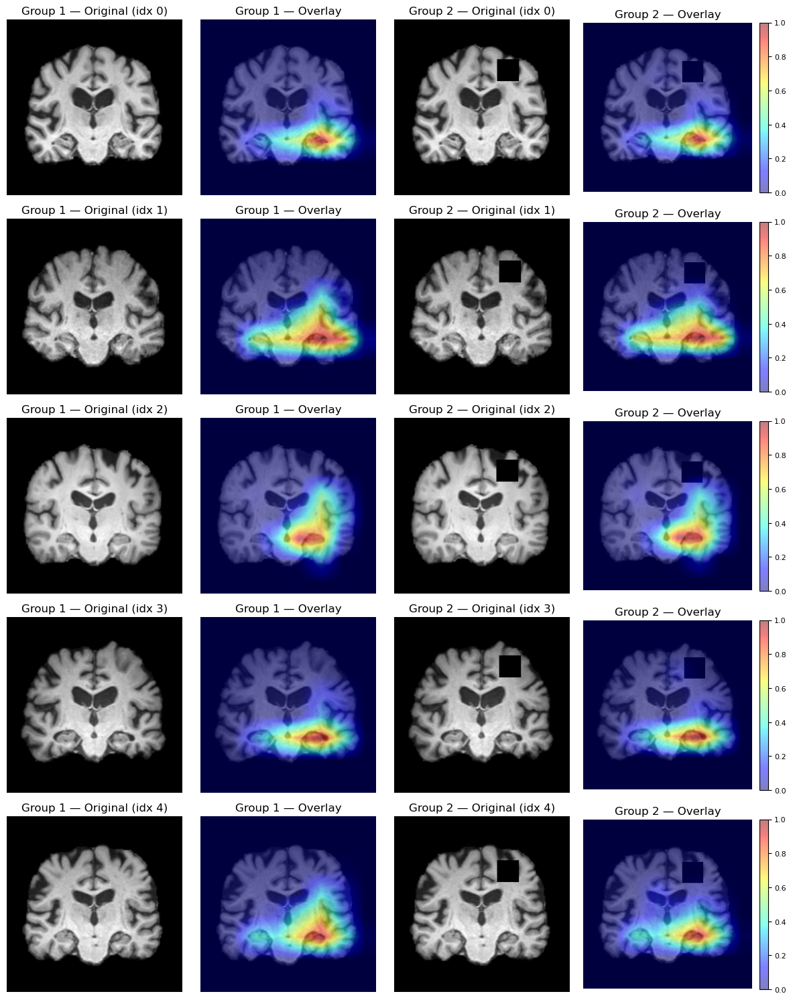

In [11]:
show_group_grid(test0_zer32, heat_gr1_fnt_test_zer, test1_zer32, heat_gr2_fnt_test_zer,
                    idxs=range(5), alpha=0.5, cmap_hm='jet', titles=True)

In [4]:
## Visualaising hetamps on corrupted images with zeroing out squares, when we fine-tune mdoel for longer
# Exp: cam-fnt7-cor : 
# Expl: I used cam from second implimentation (gradcam2.py)
# bs = 100
# n,m = 100 number of samples in each group
# I am using the fine-tuned model on ADNI dataset and first and second group

base = '../'
heatmap_dir = os.path.join(base, 'heatmaps') 
n_sample = 100
m1 = 100

expl = 'cam'
exp = 'cam-fnt7-cor'


path_heatmaps1 = os.path.join(heatmap_dir,f'gr1_{100}_{m1}_{expl}_{exp}.npy')
path_heatmaps2 = os.path.join(heatmap_dir,f'gr2_{100}_{m1}_{expl}_{exp}.npy')
heat_gr1_fnt7_cor = np.load(path_heatmaps1)
heat_gr2_fnt7_cor = np.load(path_heatmaps2)
print(heat_gr1_fnt7_cor.shape)
print(heat_gr2_fnt7_cor.shape)


(100, 256, 256)
(100, 256, 256)


In [7]:
# They are not equal 
np.array_equal(heat_gr1_fnt7_cor, heat_gr2_fnt7_cor)

False

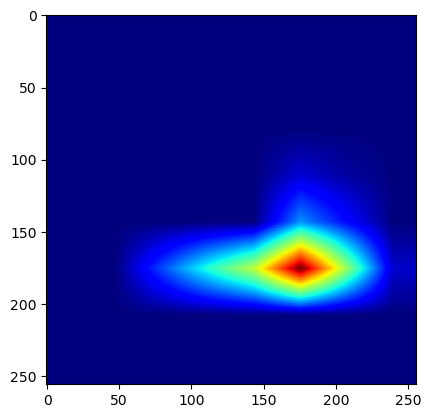

In [5]:
plt.imshow(heat_gr1_fnt7_cor[0], cmap='jet')

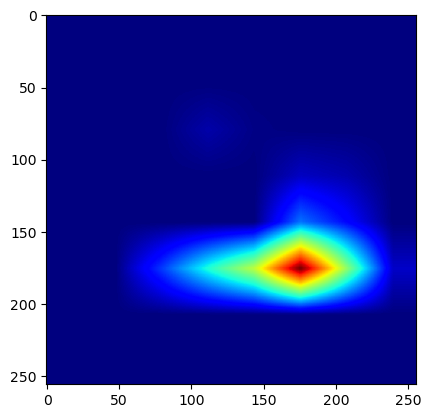

In [6]:
plt.imshow(heat_gr2_fnt7_cor[0], cmap='jet')

### Experiments with Camtum library

In [3]:
### Look at heatmpas 
expl = 'ig'
max_attr = 32
from pathlib import Path
root_dir = Path('/sc/home/masoumeh.javanbakhat/netstore-old/Baysian/3D/Explainability')
heatmap_dir = root_dir / "AdniGithub"/ "adni_results" / "heatmaps_captum"
heatmap_path = heatmap_dir / f'heatmaps_{expl}_maxattr{max_attr}_last_2_False.npz'

with np.load(heatmap_path, allow_pickle=False) as d:
    print("keys:", d.files)  # ['heatmaps', 'labels', 'predictions', 'expl', 'max_attr']

    heatmaps = d["heatmaps"]              # float32, shape (N, ...), e.g. (N, C, H, W)
    labels   = d["labels"]                # int8 -> cast if you like:
    preds    = d["predictions"]           # int8
    expl     = d["expl"].item()           # str
    max_attr = int(d["max_attr"].item())  # int

# optional: cast to standard dtypes
labels = labels.astype(np.int64)
preds  = preds.astype(np.int64)

print(heatmaps.shape, labels.shape, preds.shape, expl, max_attr)

keys: ['heatmaps', 'labels', 'predictions', 'expl', 'max_attr']
(33, 3, 256, 256) (1836,) (1836,) ig 32


In [7]:
print(np.max(heatmaps),np.min(heatmaps))

print(preds[0])
print(labels[0])

5.6304116 -5.83831
1
1


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


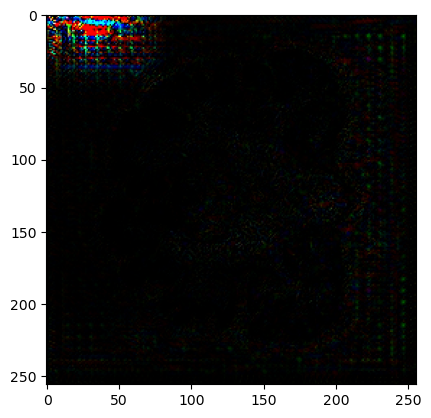

In [5]:
import matplotlib.pyplot as plt
plt.imshow(heatmaps[0].transpose(2,1,0), cmap='jet')

- When I use "IG" as explainability method, it does not have problem with OOM.
- 

In [17]:
### Look at heatmpas 
### I used noise tunnel here 
expl = 'nt'
max_attr = 4
from pathlib import Path
root_dir = Path('/sc/home/masoumeh.javanbakhat/netstore-old/Baysian/3D/Explainability')
heatmap_dir = root_dir / "AdniGithub"/ "adni_results" / "heatmaps_captum"
heatmap_path = heatmap_dir / f'heatmaps_{expl}_maxattr{max_attr}_last_2_False.npz'

with np.load(heatmap_path, allow_pickle=False) as d:
    print("keys:", d.files)  # ['heatmaps', 'labels', 'predictions', 'expl', 'max_attr']

    heatmaps = d["heatmaps"]              # float32, shape (N, ...), e.g. (N, C, H, W)
    labels   = d["labels"]                # int8 -> cast if you like:
    preds    = d["predictions"]           # int8
    expl     = d["expl"].item()           # str
    max_attr = int(d["max_attr"].item())  # int

# optional: cast to standard dtypes
labels = labels.astype(np.int64)
preds  = preds.astype(np.int64)

heatmaps_nt = heatmaps

print(heatmaps.shape, labels.shape, preds.shape, expl, max_attr)

keys: ['heatmaps', 'labels', 'predictions', 'expl', 'max_attr']
(5, 3, 256, 256) (1836,) (1836,) nt 4


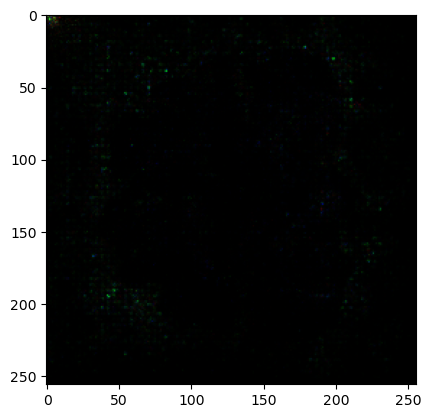

In [9]:
import matplotlib.pyplot as plt
plt.imshow(heatmaps[0].transpose(2,1,0), cmap='jet')

- If I want to visualaise heatmaps obtained from Captum library I can use the followings from Captum library:

  - attr (numpy.ndarray)

  - `captum.attr.visualization.visualize_image_attr(attr, original_image=None, method='heat_map', sign='absolute_value', plt_fig_axis=None, outlier_perc=2, cmap=None, alpha_overlay=0.5, show_colorbar=False, title=None, fig_size=(6, 6), use_pyplot=True)`

In [19]:
pwd

'/sc/home/masoumeh.javanbakhat/netstore-old/Baysian/3D/Explainability/AdniGithub/adni_results/notebook'

In [24]:
## Load images for validationn set to look at visualisation from Captum library 
from pathlib import Path
import os
here = Path.cwd()
train_dir = here.parent / "split" / "train" / "False" 

data = np.load(train_dir / "train_val_splits.npz", allow_pickle=False)

X_train = data["X_train"]; y_train = data["y_train"]
X_val   = data["X_val"];   y_val   = data["y_val"]
print(X_train.shape, y_train.shape, X_val.shape, y_val.shape)


(5510, 256, 256) (5510,) (1836, 256, 256) (1836,)


In [27]:
### repeat numbre of channles to 3 for images in validation set
# check what is the type of X_val
imgs_3 = np.repeat(X_val[:, None, :, :], 3, axis=1)
print(imgs_3.shape)

# get first 5 images from val loader
val_imgs_5 = imgs_3[:5]

print(val_imgs_5.shape)

(1836, 3, 256, 256)
(5, 3, 256, 256)


In [28]:
print(heatmaps_nt.shape)

(5, 3, 256, 256)


- The following is the visualisation from IG with noise tunnel from Captum library

In [36]:
import captum
from captum.attr import visualization as viz
from matplotlib.colors import LinearSegmentedColormap
# In the following: attr (nd-array:(H,W,C))
# Original image: img ((H,W,C))
# Here we visualize heatmaps noise-tunnel: heatmaps_nt:[5,3,256,256]

default_cmap = LinearSegmentedColormap.from_list('custom blue', 
                                                 [(0, '#ffffff'),
                                                  (0.25, '#000000'),
                                                  (1, '#000000')], N=256)

from captum.attr import visualization as viz
import numpy as np

default_cmap = "magma"  # or any matplotlib cmap

for i in range(5):
    img = np.transpose(val_imgs_5[i], (1, 2, 0))          # (H, W, C)
    attr = np.transpose(heatmaps_nt[i], (1, 2, 0))   # (H,W,C)
    
    print(f'img:{img.shape}')
    print(f'attr:{attr.shape}')    

    viz.visualize_image_attr_multiple(
        attr,
        img,
        methods = ["original_image", "heat_map"],
        signs=["all", "positive"],
        cmap=default_cmap,
        show_colorbar=True)

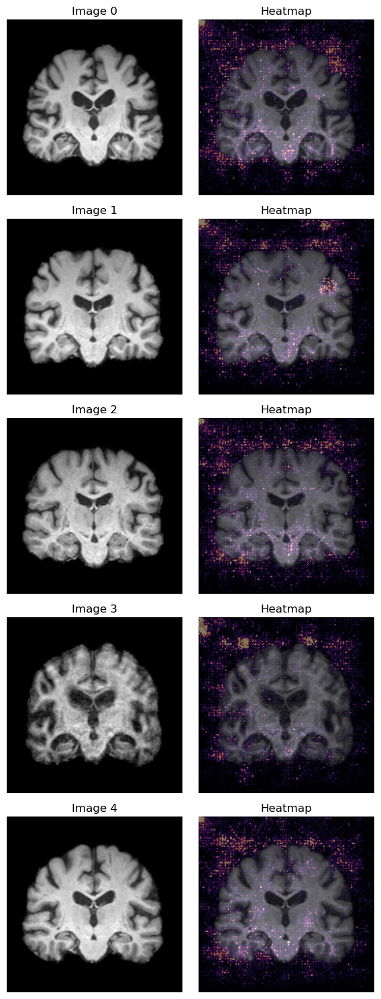

In [35]:
import numpy as np
import matplotlib.pyplot as plt

def overlay(img_chw, attr_chw, alpha=0.5, signed=False, title=None):
    """
    img_chw: (C,H,W) np.float32
    attr_chw: (C,H,W) np.float32 from Captum
    """
    # collapse channels on attribution
    heat = (attr_chw.sum(0) if signed else np.abs(attr_chw).sum(0))  # (H,W)

    # robust normalize heat 0..1
    h = heat.astype(np.float32)
    h = (h - np.percentile(h, 1)) / (np.percentile(h, 99) - np.percentile(h, 1) + 1e-8)
    h = np.clip(h, 0, 1)

    # make display image (grayscale or RGB)
    if img_chw.shape[0] == 1:
        img_disp = img_chw[0]
        plt.imshow(img_disp, cmap="gray")
    else:
        img_disp = np.transpose(img_chw, (1,2,0))
        # normalize to [0,1] for imshow to avoid the clipping warning
        m, M = img_disp.min(), img_disp.max()
        img_disp = (img_disp - m) / (M - m + 1e-8)
        plt.imshow(img_disp)

    plt.imshow(h, cmap="magma", alpha=alpha)
    if title: plt.title(title)
    plt.axis("off")

def show_grid(images_nchw, attrs_nchw, n=5):
    n = min(n, len(images_nchw))
    fig, axes = plt.subplots(n, 2, figsize=(6, 3*n))
    for i in range(n):
        img = images_nchw[i]      # (C,H,W)
        attr = attrs_nchw[i]      # (C,H,W)
        plt.sca(axes[i,0]); overlay(img, np.zeros_like(img), alpha=0.0, title=f"Image {i}")
        plt.sca(axes[i,1]); overlay(img, attr, alpha=0.5, title="Heatmap")
    plt.tight_layout(); plt.show()

# Example:
# images: (N,3,256,256)  or (N,1,256,256)
# heatmaps: (N,3,256,256) from Captum (IG/NT/Grad-CAM upsampled)
show_grid(val_imgs_5, heatmaps_nt, n=5)
